<a href="https://colab.research.google.com/github/Advay-21/College_Experiments/blob/main/Image_Processing_and_Computer_Vision_II.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Experiment 0

In [ ]:
import cv2
import numpy as np
import time
from skimage.metrics import structural_similarity as ssim

In [ ]:
# Load images
image_paths = ["/content/IPCV2_Exp0_1.jpg", "/content/IPCV2_Exp0_2.jpg"]
images = [cv2.imread(img, cv2.IMREAD_GRAYSCALE) for img in image_paths]

In [ ]:
# Display image dimensions
for i, img in enumerate(images):
    print(f"Image {i+1} Dimensions: {img.shape}")

Image 1 Dimensions: (640, 1280)
Image 2 Dimensions: (980, 980)


In [ ]:
# Define filters
def apply_sobel(img):
    grad_x = cv2.Sobel(img, cv2.CV_64F, 1, 0, ksize=3)
    grad_y = cv2.Sobel(img, cv2.CV_64F, 0, 1, ksize=3)
    return cv2.magnitude(grad_x, grad_y)

In [ ]:
def apply_gabor(img, ksize=31, sigma=4.0, theta=np.pi/4, lamda=10.0, gamma=0.5):
    gabor_filter = cv2.getGaborKernel((ksize, ksize), sigma, theta, lamda, gamma)
    return cv2.filter2D(img, cv2.CV_64F, gabor_filter)

In [ ]:
def apply_gaussian(img, ksize=5, sigma=1):
    return cv2.GaussianBlur(img, (ksize, ksize), sigma)

In [ ]:
filtered_images = {"Sobel": [], "Gabor": [], "Gaussian": []}
times = {"Sobel": [], "Gabor": [], "Gaussian": []}

In [ ]:
# Apply filters and measure execution time
for img in images:
    for name, func in [("Sobel", apply_sobel), ("Gabor", apply_gabor), ("Gaussian", apply_gaussian)]:
        start_time = time.time()
        filtered_images[name].append(func(img))
        times[name].append(time.time() - start_time)

In [ ]:
def calculate_snr(original, filtered):
    signal = np.mean(filtered**2)
    noise = np.mean((original - filtered)**2)
    return 10 * np.log10(signal / noise)

In [ ]:
# Metrics computation
snr_values = {"Sobel": [], "Gabor": [], "Gaussian": []}
ssim_values = {"Sobel": [], "Gabor": [], "Gaussian": []}

In [ ]:
for img, name in zip(images, range(len(images))):
    for filter_name, filtered_img in filtered_images.items():
        snr_values[filter_name].append(calculate_snr(img, filtered_img[name]))
        # Specify data_range for ssim
        ssim_values[filter_name].append(ssim(img, filtered_img[name], data_range=255))

In [ ]:
import pandas as pd
# Summarize results
results = pd.DataFrame({
    "Filter": ["Sobel", "Gabor", "Gaussian"],
    "SNR (dB)": [np.mean(snr_values[f]) for f in snr_values],
    "SSIM": [np.mean(ssim_values[f]) for f in ssim_values],
    "Execution Time (s)": [np.mean(times[f]) for f in times],
})

In [ ]:
results

,Filter,SNR (dB),SSIM,Execution Time (s)
0,Sobel,-4.978533,0.658095,0.037968
1,Gabor,-0.433669,0.576848,0.027832
2,Gaussian,0.826311,0.982768,0.008707


In [ ]:
import matplotlib.pyplot as plt
# Function to display images
def display_images(original, sobel, gabor, gaussian, title):
    fig, axes = plt.subplots(1, 4, figsize=(20, 5))
    axes[0].imshow(original, cmap="gray")
    axes[0].set_title(f"Original - {title}")
    axes[1].imshow(sobel, cmap="gray")
    axes[1].set_title("Sobel Filter")
    axes[2].imshow(gabor, cmap="gray")
    axes[2].set_title("Gabor Filter")
    axes[3].imshow(gaussian, cmap="gray")
    axes[3].set_title("Gaussian Filter")
    for ax in axes:
        ax.axis("off")
    plt.tight_layout()
    plt.show()

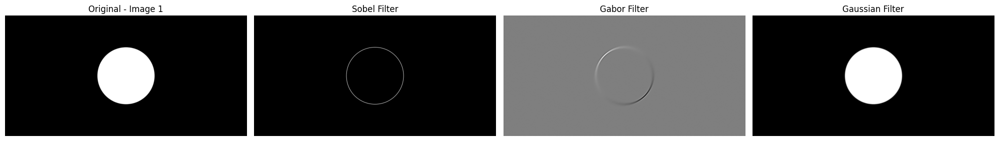

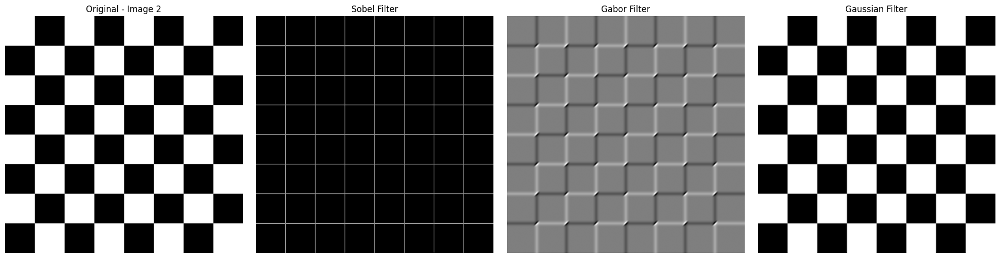

In [ ]:
# Display images for both loaded images
for i, img in enumerate(images):
    display_images(
        img,
        filtered_images["Sobel"][i],
        filtered_images["Gabor"][i],
        filtered_images["Gaussian"][i],
        title=f"Image {i+1}"
    )

# Experiment 1

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import zipfile
import os

**Prepare the Dataset**

In [ ]:
dataset_path = "/content/drive/My Drive/archive.zip"
extract_path = "/content/dataset"

In [ ]:
with zipfile.ZipFile(dataset_path, 'r') as zip_ref:
    zip_ref.extractall(extract_path)
print("Extraction Complete!")

Extraction Complete!


In [ ]:
data_dir = "/content/dataset/cell_images"
print("Contents of dataset folder:", os.listdir(data_dir))

Contents of dataset folder: ['Uninfected', 'cell_images', 'Parasitized']


In [ ]:
import os
import numpy as np
import cv2
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt

In [ ]:
# Define paths
dataset_path = "/content/dataset/cell_images"
infected_path = os.path.join(dataset_path, "Parasitized")
uninfected_path = os.path.join(dataset_path, "Uninfected")

In [ ]:
# Image size (we will resize all images to this size)
IMG_SIZE = 128
# Prepare lists for images and labels
X = []  # Image data
y = []  # Labels (1 for Parasitized, 0 for Uninfected)

In [ ]:
# Load Parasitized images
for img_name in os.listdir(infected_path):
    img_path = os.path.join(infected_path, img_name)
    img = cv2.imread(img_path)
    if img is not None:
        img = cv2.resize(img, (IMG_SIZE, IMG_SIZE))  # Resize
        img = img / 255.0  # Normalize
        X.append(img)
        y.append(1)  # Label for Parasitized

In [ ]:
# Load Uninfected images
for img_name in os.listdir(uninfected_path):
    img_path = os.path.join(uninfected_path, img_name)
    img = cv2.imread(img_path)
    if img is not None:
        img = cv2.resize(img, (IMG_SIZE, IMG_SIZE))  # Resize
        img = img / 255.0  # Normalize
        X.append(img)
        y.append(0)  # Label for Uninfected

In [ ]:
# Convert lists to numpy arrays
X = np.array(X)
y = np.array(y)

In [ ]:
# Split into train (80%) and test (20%)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42, stratify=y)

In [ ]:
# Print dataset details
print(f"Total images: {len(X)}")
print(f"Training images: {len(X_train)}")
print(f"Testing images: {len(X_test)}")

Total images: 27558
Training images: 22046
Testing images: 5512


In [ ]:
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Dropout

**Design the CNN Model**

In [ ]:
# Define CNN model
model = Sequential([
    # First Convolutional Layer
    Conv2D(32, (3,3), activation='relu', input_shape=(128, 128, 3)),
    MaxPooling2D(pool_size=(2,2)),
    # Second Convolutional Layer
    Conv2D(64, (3,3), activation='relu'),
    MaxPooling2D(pool_size=(2,2)),
    # Third Convolutional Layer
    Conv2D(128, (3,3), activation='relu'),
    MaxPooling2D(pool_size=(2,2)),
    # Flatten the output
    Flatten(),
    # Fully Connected Layer
    Dense(128, activation='relu'),
    Dropout(0.5),  # Dropout to prevent overfitting
    # Output Layer
    Dense(1, activation='sigmoid')  # Sigmoid for binary classification
])

In [ ]:
import warnings
warnings.filterwarnings("ignore")

In [ ]:
# Compile the model
model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

In [ ]:
# Model Summary
model.summary()

Model: "sequential_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ conv2d_3 (Conv2D)                    │ (None, 126, 126, 32)        │             896 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_3 (MaxPooling2D)       │ (None, 63, 63, 32)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_4 (Conv2D)                    │ (None, 61, 61, 64)          │          18,496 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_4 (MaxPooling2D)       │ (None, 30, 30, 64)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_5 (Conv2D)                    │ (None, 28, 28, 128)         │          73,856 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_5 (MaxPooling2D)       │ (None, 14, 14, 128)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten_1 (Flatten)                  │ (None, 25088)               │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 128)                 │       3,211,392 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_1 (Dropout)                  │ (None, 128)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 1)                   │             129 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 3,304,769 (12.61 MB)

 Trainable params: 3,304,769 (12.61 MB)

 Non-trainable params: 0 (0.00 B)

In [ ]:
# Define batch size and number of epochs
batch_size = 32
epochs = 15  # You can increase if needed

**Training the Model**

In [ ]:
# Train the model
history = model.fit(X_train, y_train,
                    batch_size=batch_size,
                    epochs=epochs,
                    validation_data=(X_test, y_test))

Epoch 1/15
689/689 ━━━━━━━━━━━━━━━━━━━━ 37s 43ms/step - accuracy: 0.6679 - loss: 0.5840 - val_accuracy: 0.9536 - val_loss: 0.1399
Epoch 2/15
689/689 ━━━━━━━━━━━━━━━━━━━━ 23s 33ms/step - accuracy: 0.9564 - loss: 0.1514 - val_accuracy: 0.9594 - val_loss: 0.1127
Epoch 3/15
689/689 ━━━━━━━━━━━━━━━━━━━━ 23s 32ms/step - accuracy: 0.9601 - loss: 0.1424 - val_accuracy: 0.9695 - val_loss: 0.1005
Epoch 4/15
689/689 ━━━━━━━━━━━━━━━━━━━━ 23s 32ms/step - accuracy: 0.9533 - loss: 0.1413 - val_accuracy: 0.9695 - val_loss: 0.1008
Epoch 5/15
689/689 ━━━━━━━━━━━━━━━━━━━━ 22s 32ms/step - accuracy: 0.9638 - loss: 0.1150 - val_accuracy: 0.9681 - val_loss: 0.0958
Epoch 6/15
689/689 ━━━━━━━━━━━━━━━━━━━━ 23s 32ms/step - accuracy: 0.9748 - loss: 0.0970 - val_accuracy: 0.9666 - val_loss: 0.1123
Epoch 7/15
689/689 ━━━━━━━━━━━━━━━━━━━━ 23s 32ms/step - accuracy: 0.9623 - loss: 0.0909 - val_accuracy: 0.9681 - val_loss: 0.0926
Epoch 8/15
689/689 ━━━━━━━━━━━━━━━━━━━━ 23s 32ms/step - accuracy: 0.9694 - loss: 0.0815 - 

In [ ]:
import matplotlib.pyplot as plt
# Extract accuracy and loss from history
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']
loss = history.history['loss']
val_loss = history.history['val_loss']
epochs_range = range(len(acc))

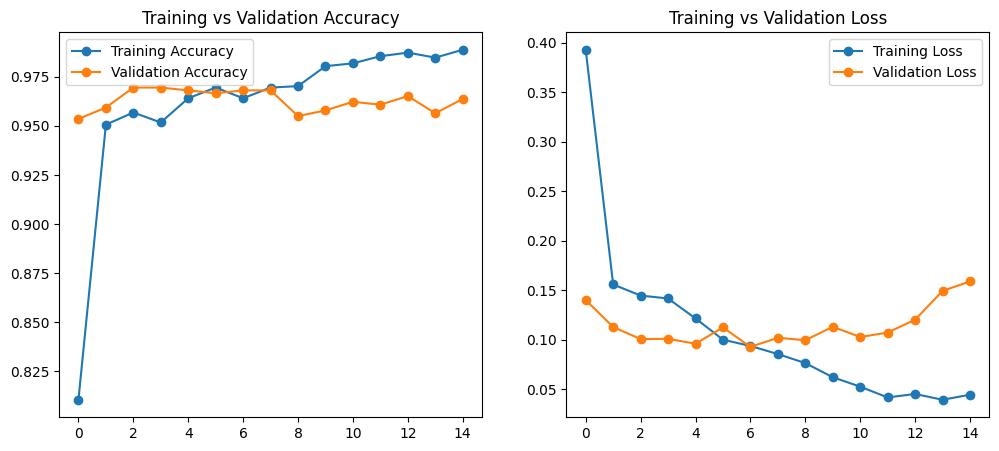

In [ ]:
# Plot accuracy curves
plt.figure(figsize=(12, 5))
plt.subplot(1, 2, 1)
plt.plot(epochs_range, acc, label='Training Accuracy', marker='o')
plt.plot(epochs_range, val_acc, label='Validation Accuracy', marker='o')
plt.legend()
plt.title('Training vs Validation Accuracy')
# Plot loss curves
plt.subplot(1, 2, 2)
plt.plot(epochs_range, loss, label='Training Loss', marker='o')
plt.plot(epochs_range, val_loss, label='Validation Loss', marker='o')
plt.legend()
plt.title('Training vs Validation Loss')
plt.show()

In [ ]:
test_loss, test_acc = model.evaluate(X_test, y_test)
print(f"📢 Test Accuracy: {test_acc:.4f}")

173/173 ━━━━━━━━━━━━━━━━━━━━ 4s 23ms/step - accuracy: 0.9716 - loss: 0.1131
📢 Test Accuracy: 0.9637


**Analyse Misclassified Images**

In [ ]:
import numpy as np
# Get predictions
y_pred = model.predict(X_test)
y_pred_classes = (y_pred > 0.5).astype("int32")  # Convert probabilities to binary (0/1)

173/173 ━━━━━━━━━━━━━━━━━━━━ 13s 63ms/step


In [ ]:
# Identify misclassified indices
misclassified_idxs = np.where(y_pred_classes.flatten() != y_test.flatten())[0]
# Display some misclassified images
import matplotlib.pyplot as plt
num_images = 9  # Display 9 misclassified images

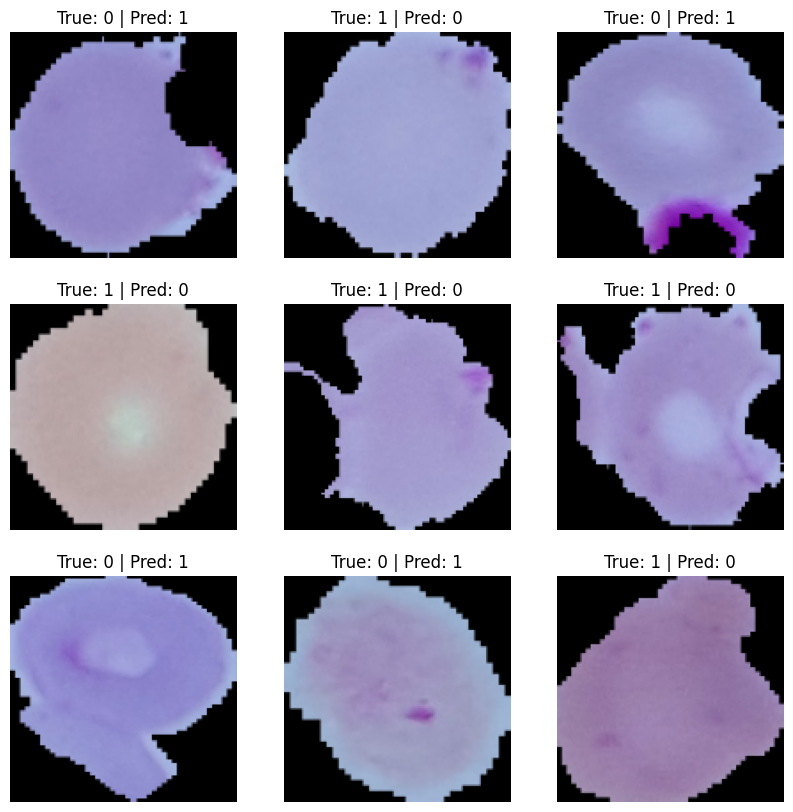

In [ ]:
plt.figure(figsize=(10, 10))
for i, idx in enumerate(misclassified_idxs[:num_images]):
    plt.subplot(3, 3, i + 1)
    plt.imshow(X_test[idx])  # Assuming images are in correct format
    plt.title(f"True: {y_test[idx]} | Pred: {y_pred_classes[idx][0]}")
    plt.axis("off")
plt.show()

**Predict on New Images**

**Parasitized Image Testing**

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 477ms/step


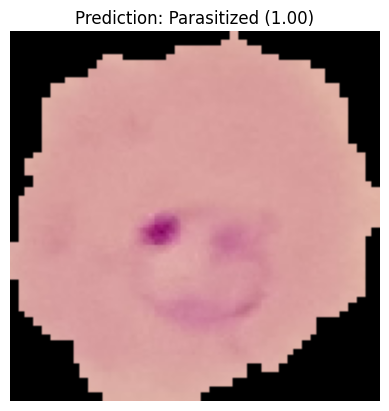

In [ ]:
from tensorflow.keras.preprocessing import image
# Load a new image
img_path = "/content/dataset/cell_images/Parasitized/C100P61ThinF_IMG_20150918_144104_cell_162.png"  # Change this path
img = image.load_img(img_path, target_size=(128, 128))
img_array = image.img_to_array(img) / 255.0  # Normalize
img_array = np.expand_dims(img_array, axis=0)  # Add batch dimension
# Make prediction
prediction = model.predict(img_array)[0][0]
# Show the result
plt.imshow(img)
plt.title(f"Prediction: {'Parasitized' if prediction > 0.5 else 'Uninfected'} ({prediction:.2f})")
plt.axis("off")
plt.show()

**Uninfected Image Testing**

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 488ms/step


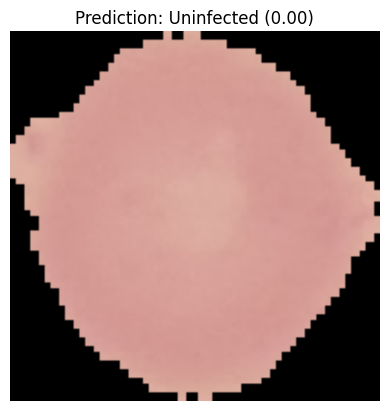

In [ ]:
from tensorflow.keras.preprocessing import image
# Load a new image
img_path = "/content/dataset/cell_images/Uninfected/C100P61ThinF_IMG_20150918_144104_cell_128.png"  # Change this path
img = image.load_img(img_path, target_size=(128, 128))
img_array = image.img_to_array(img) / 255.0  # Normalize
img_array = np.expand_dims(img_array, axis=0)  # Add batch dimension
# Make prediction
prediction = model.predict(img_array)[0][0]
# Show the result
plt.imshow(img)
plt.title(f"Prediction: {'Parasitized' if prediction > 0.5 else 'Uninfected'} ({prediction:.2f})")
plt.axis("off")
plt.show()

# Experiment 2.1

**Mask RCNN**

In [ ]:
import torch
import torchvision
from torchvision.models.detection import maskrcnn_resnet50_fpn
import torchvision.transforms as transforms
from PIL import Image
import matplotlib.pyplot as plt
import numpy as np
import cv2

In [ ]:
# Load pre-trained Mask R-CNN model
model = maskrcnn_resnet50_fpn(pretrained=True)
model.eval()

MaskRCNN(
  (transform): GeneralizedRCNNTransform(
      Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
      Resize(min_size=(800,), max_size=1333, mode='bilinear')
  )
  (backbone): BackboneWithFPN(
    (body): IntermediateLayerGetter(
      (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
      (bn1): FrozenBatchNorm2d(64, eps=0.0)
      (relu): ReLU(inplace=True)
      (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
      (layer1): Sequential(
        (0): Bottleneck(
          (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn1): FrozenBatchNorm2d(64, eps=0.0)
          (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn2): FrozenBatchNorm2d(64, eps=0.0)
          (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn3): FrozenBatchNorm2d(256, eps=0.0)
          (relu): ReLU(in

In [ ]:
# Load and preprocess an image
def preprocess_image(image_path):
    transform = transforms.Compose([
        transforms.ToTensor()
    ])
    image = Image.open(image_path).convert("RGB")
    return transform(image).unsqueeze(0)

In [ ]:
# Perform inference
def predict(image_path):
    image = preprocess_image(image_path)
    with torch.no_grad():
        predictions = model(image)
    return predictions

In [ ]:
# Predefined list of distinct colors (bright and unique)
COLOR_LIST = [
    (255, 0, 0),    # Red
    (0, 255, 0),    # Green
    (0, 0, 255),    # Blue
    (255, 165, 0),  # Orange
    (128, 0, 128),  # Purple
    (255, 255, 0),  # Yellow
    (0, 255, 255),  # Cyan
    (255, 192, 203) # Pink
]

In [ ]:
# Visualize results with distinct mask colors
def show_predictions(image_path, predictions, threshold=0.5):
    image = np.array(Image.open(image_path).convert("RGB"))
    overlay = image.copy()
    # Extract valid objects
    valid_objects = [(box, mask, score) for box, mask, score in
                     zip(predictions[0]['boxes'], predictions[0]['masks'], predictions[0]['scores']) if score > threshold]
    # Assign distinct colors from the list, cycling if needed
    num_objects = len(valid_objects)
    colors = [COLOR_LIST[i % len(COLOR_LIST)] for i in range(num_objects)]
    for i, (box, mask, score) in enumerate(valid_objects):
        x1, y1, x2, y2 = map(int, box.numpy())
        mask = mask.squeeze().numpy()
        mask = (mask > 0.5).astype(np.uint8)  # Binarize mask
        # Create a colored mask
        color = np.array(colors[i], dtype=np.uint8)
        colored_mask = np.zeros_like(image, dtype=np.uint8)
        for c in range(3):
            colored_mask[:, :, c] = mask * color[c]
        # Overlay mask with transparency
        overlay = cv2.addWeighted(overlay, 1.0, colored_mask, 0.5, 0)  # Alpha=0.5 for better visibility
        cv2.rectangle(overlay, (x1, y1), (x2, y2), (0, 0, 255), 2)  # Keep bounding boxes red
    # Show final image
    plt.figure(figsize=(10, 6))
    plt.imshow(overlay)
    plt.axis("off")
    plt.show()

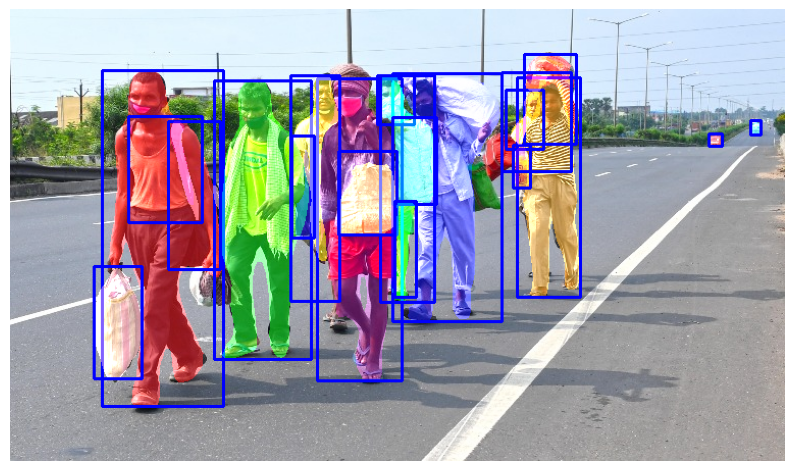

In [ ]:
# Example usage
image_path = "/content/migrants-salil.jpg"  # Replace with actual image path
predictions = predict(image_path)
show_predictions(image_path, predictions)

**Faster RCNN**

In [ ]:
import torch
import torchvision
from torchvision.models.detection import fasterrcnn_resnet50_fpn
import torchvision.transforms as transforms
from PIL import Image
import matplotlib.pyplot as plt
import numpy as np
import cv2

In [ ]:
# Load pre-trained Faster R-CNN model
model = fasterrcnn_resnet50_fpn(pretrained=True)
model.eval()

/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=FasterRCNN_ResNet50_FPN_Weights.COCO_V1`. You can also use `weights=FasterRCNN_ResNet50_FPN_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/fasterrcnn_resnet50_fpn_coco-258fb6c6.pth" to /root/.cache/torch/hub/checkpoints/fasterrcnn_resnet50_fpn_coco-258fb6c6.pth
100%|██████████| 160M/160M [00:01<00:00, 138MB/s]


FasterRCNN(
  (transform): GeneralizedRCNNTransform(
      Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
      Resize(min_size=(800,), max_size=1333, mode='bilinear')
  )
  (backbone): BackboneWithFPN(
    (body): IntermediateLayerGetter(
      (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
      (bn1): FrozenBatchNorm2d(64, eps=0.0)
      (relu): ReLU(inplace=True)
      (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
      (layer1): Sequential(
        (0): Bottleneck(
          (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn1): FrozenBatchNorm2d(64, eps=0.0)
          (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn2): FrozenBatchNorm2d(64, eps=0.0)
          (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn3): FrozenBatchNorm2d(256, eps=0.0)
          (relu): ReLU(

In [ ]:
# Load and preprocess an image
def preprocess_image(image_path):
    transform = transforms.Compose([
        transforms.ToTensor()
    ])
    image = Image.open(image_path).convert("RGB")
    return transform(image).unsqueeze(0)

In [ ]:
# Perform inference
def predict(image_path):
    image = preprocess_image(image_path)
    with torch.no_grad():
        predictions = model(image)
    return predictions

In [ ]:
# Visualize results with bounding boxes
def show_predictions(image_path, predictions, threshold=0.5):
    image = np.array(Image.open(image_path).convert("RGB"))
    fig, ax = plt.subplots(1, figsize=(10, 6))
    ax.imshow(image)
    for box, score in zip(predictions[0]['boxes'], predictions[0]['scores']):
        if score > threshold:
            x1, y1, x2, y2 = box.numpy()
            ax.add_patch(plt.Rectangle((x1, y1), x2-x1, y2-y1, fill=False, color='red', linewidth=2))
            ax.text(x1, y1, f"Score: {score:.2f}", bbox=dict(facecolor='yellow', alpha=0.5))
    plt.show()

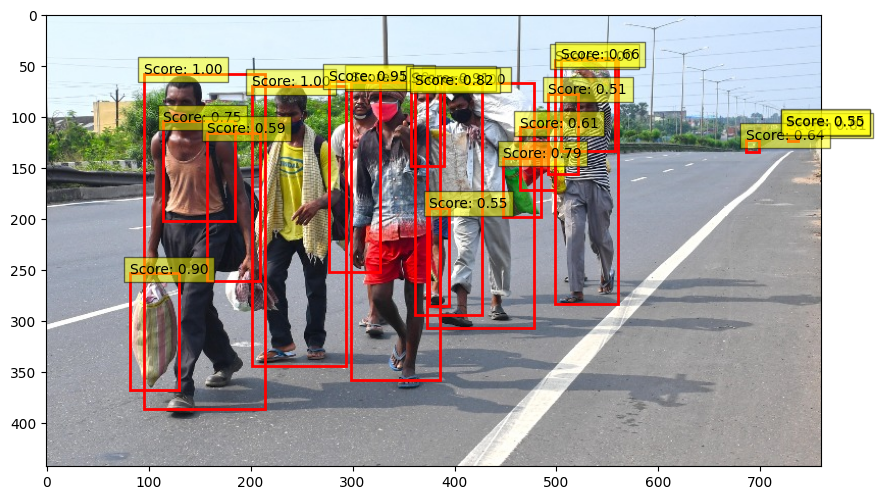

In [ ]:
# Example usage
image_path = "/content/migrants-salil.jpg"  # Replace with actual image path
predictions = predict(image_path)
show_predictions(image_path, predictions)

**IOU**

In [ ]:
import torch
import torchvision
from torchvision.models.detection import fasterrcnn_resnet50_fpn, maskrcnn_resnet50_fpn
import torchvision.transforms as transforms
from PIL import Image
import matplotlib.pyplot as plt
import numpy as np
import cv2

In [ ]:
def calculate_iou(box1, box2):
    x1 = max(box1[0], box2[0])
    y1 = max(box1[1], box2[1])
    x2 = min(box1[2], box2[2])
    y2 = min(box1[3], box2[3])
    intersection = max(0, x2 - x1) * max(0, y2 - y1)
    box1_area = (box1[2] - box1[0]) * (box1[3] - box1[1])
    box2_area = (box2[2] - box2[0]) * (box2[3] - box2[1])
    union = box1_area + box2_area - intersection
    return intersection / union if union > 0 else 0

In [ ]:
# Load pre-trained models
faster_rcnn = fasterrcnn_resnet50_fpn(pretrained=True).eval()
mask_rcnn = maskrcnn_resnet50_fpn(pretrained=True).eval()

In [ ]:
def preprocess_image(image_path):
    transform = transforms.Compose([
        transforms.ToTensor()
    ])
    image = Image.open(image_path).convert("RGB")
    return transform(image).unsqueeze(0)

In [ ]:
def predict(model, image_path):
    image = preprocess_image(image_path)
    with torch.no_grad():
        predictions = model(image)
    return predictions

In [ ]:
def compute_iou_for_models(image_path, ground_truth_box):
    faster_predictions = predict(faster_rcnn, image_path)
    mask_predictions = predict(mask_rcnn, image_path)
    faster_boxes = faster_predictions[0]['boxes'].numpy() if len(faster_predictions[0]['boxes']) > 0 else []
    mask_boxes = mask_predictions[0]['boxes'].numpy() if len(mask_predictions[0]['boxes']) > 0 else []
    iou_faster = max([calculate_iou(ground_truth_box, pred) for pred in faster_boxes] if len(faster_boxes) > 0 else [0])
    iou_mask = max([calculate_iou(ground_truth_box, pred) for pred in mask_boxes] if len(mask_boxes) > 0 else [0])
    return iou_faster, iou_mask

In [ ]:
# Example usage
image_path = "/content/migrants-salil.jpg"  # Replace with actual image path
ground_truth_box = [50, 50, 200, 200]  # Replace with actual ground truth box
iou_faster, iou_mask = compute_iou_for_models(image_path, ground_truth_box)

In [ ]:
print(f"IoU for Faster R-CNN: {iou_faster:.4f}")
print(f"IoU for Mask R-CNN: {iou_mask:.4f}")

IoU for Faster R-CNN: 0.3182
IoU for Mask R-CNN: 0.3277


# Experiment 2.2

In [ ]:
import torch
import torchvision
from torchvision.models.detection import maskrcnn_resnet50_fpn
import torchvision.transforms as transforms
from PIL import Image
import matplotlib.pyplot as plt
import numpy as np
import cv2
import os
import zipfile

In [ ]:
# Define dataset path
zip_path = "/content/archive.zip"
extract_path = "/content/dataset"

In [ ]:
# Extract the zip file
if not os.path.exists(extract_path):
    with zipfile.ZipFile(zip_path, 'r') as zip_ref:
        zip_ref.extractall(extract_path)

In [ ]:
# Define image folders
train_folder = os.path.join(extract_path, "images/train")
val_folder = os.path.join(extract_path, "images/val")

In [ ]:
# Load pre-trained Mask R-CNN model
model = maskrcnn_resnet50_fpn(pretrained=True)
model.eval()

MaskRCNN(
  (transform): GeneralizedRCNNTransform(
      Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
      Resize(min_size=(800,), max_size=1333, mode='bilinear')
  )
  (backbone): BackboneWithFPN(
    (body): IntermediateLayerGetter(
      (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
      (bn1): FrozenBatchNorm2d(64, eps=0.0)
      (relu): ReLU(inplace=True)
      (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
      (layer1): Sequential(
        (0): Bottleneck(
          (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn1): FrozenBatchNorm2d(64, eps=0.0)
          (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn2): FrozenBatchNorm2d(64, eps=0.0)
          (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn3): FrozenBatchNorm2d(256, eps=0.0)
          (relu): ReLU(in

In [ ]:
# Function to load and preprocess an image
def preprocess_image(image_path):
    transform = transforms.Compose([transforms.ToTensor()])
    image = Image.open(image_path).convert("RGB")
    return transform(image).unsqueeze(0)

In [ ]:
# Perform inference
def predict(image_path):
    image = preprocess_image(image_path)
    with torch.no_grad():
        predictions = model(image)
    return predictions

In [ ]:
# Predefined distinct colors for masks
COLOR_LIST = [
    (255, 0, 0),    # Red
    (0, 255, 0),    # Green
    (0, 0, 255),    # Blue
    (255, 165, 0),  # Orange
    (128, 0, 128),  # Purple
    (255, 255, 0),  # Yellow
    (0, 255, 255),  # Cyan
    (255, 192, 203) # Pink
]

In [ ]:
# Function to visualize predictions
def show_predictions(image_path, predictions, threshold=0.3):
    image = np.array(Image.open(image_path).convert("RGB"))
    overlay = image.copy()
    # Extract valid objects
    valid_objects = [(box, mask, score) for box, mask, score in
                     zip(predictions[0]['boxes'], predictions[0]['masks'], predictions[0]['scores']) if score > threshold]
    # Assign distinct colors from the list, cycling if needed
    num_objects = len(valid_objects)
    colors = [COLOR_LIST[i % len(COLOR_LIST)] for i in range(num_objects)]
    for i, (box, mask, score) in enumerate(valid_objects):
        x1, y1, x2, y2 = map(int, box.numpy())
        mask = mask.squeeze().numpy()
        mask = (mask > 0.5).astype(np.uint8)  # Binarize mask
        # Create a colored mask
        color = np.array(colors[i], dtype=np.uint8)
        colored_mask = np.zeros_like(image, dtype=np.uint8)
        for c in range(3):
            colored_mask[:, :, c] = mask * color[c]
        # Overlay mask with transparency
        overlay = cv2.addWeighted(overlay, 1.0, colored_mask, 0.5, 0)  # Alpha=0.5 for better visibility
        cv2.rectangle(overlay, (x1, y1), (x2, y2), (0, 0, 255), 2)  # Keep bounding boxes red
    # Show final image
    plt.figure(figsize=(10, 6))
    plt.imshow(overlay)
    plt.axis("off")
    plt.show()

In [ ]:
# Get all image file paths
def get_image_files(folder):
    return [os.path.join(folder, file) for file in os.listdir(folder) if file.endswith((".jpg", ".png", ".jpeg"))]

Processing 749 images from /content/dataset/images/train...

Processing /content/dataset/images/train/aircraft_479.jpg


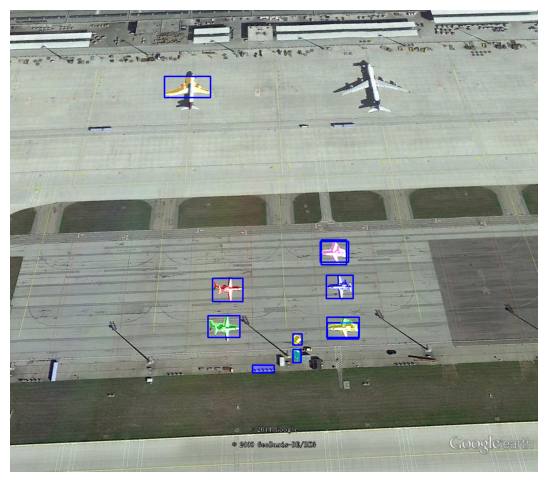

Processing /content/dataset/images/train/overpass_314.jpg


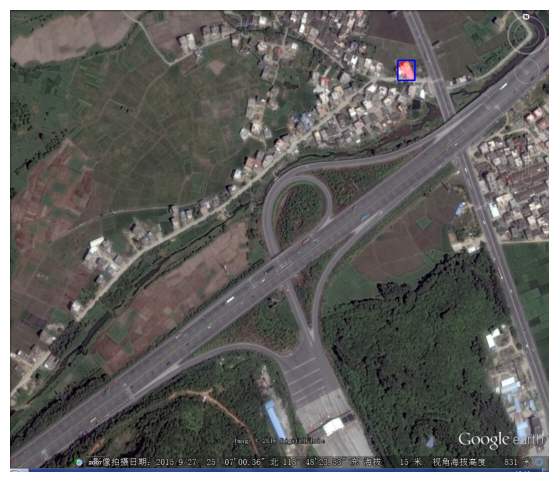

Processing /content/dataset/images/train/overpass_352.jpg


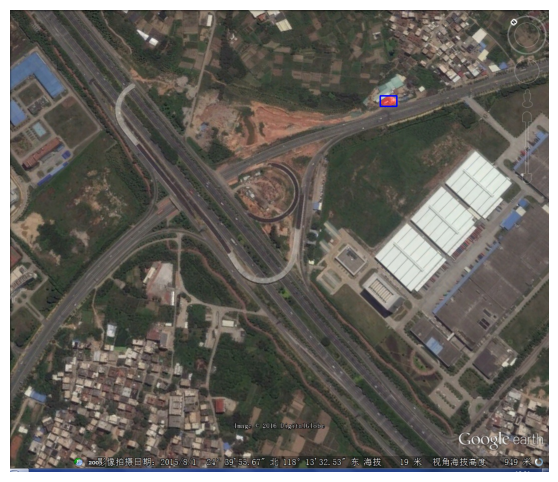

Processing /content/dataset/images/train/aircraft_348.jpg


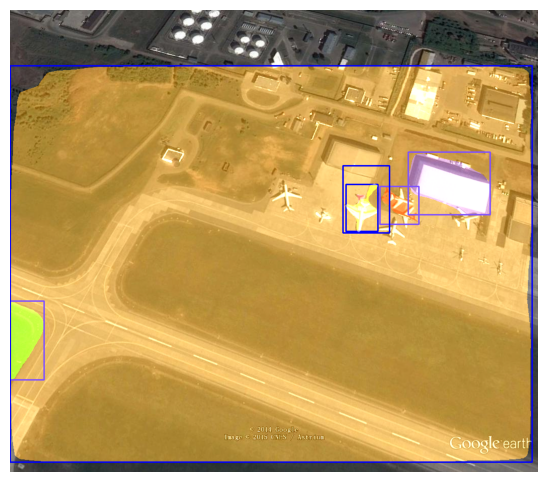

Processing /content/dataset/images/train/aircraft_195.jpg


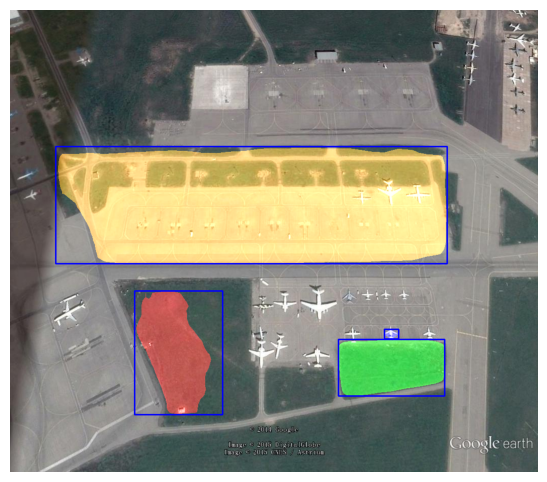

Processing 187 images from /content/dataset/images/val...

Processing /content/dataset/images/val/oiltank_445.jpg


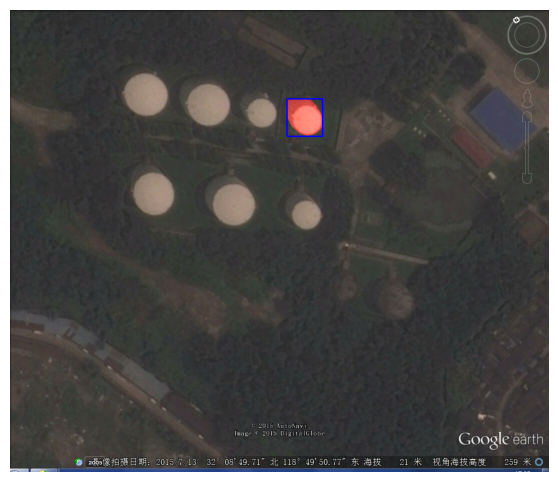

Processing /content/dataset/images/val/aircraft_1060.jpg


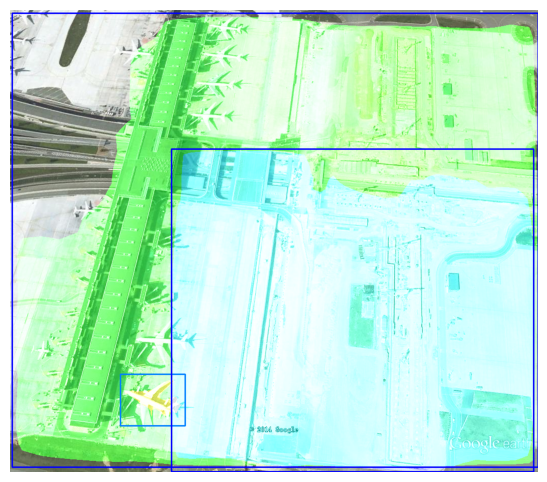

Processing /content/dataset/images/val/aircraft_1039.jpg


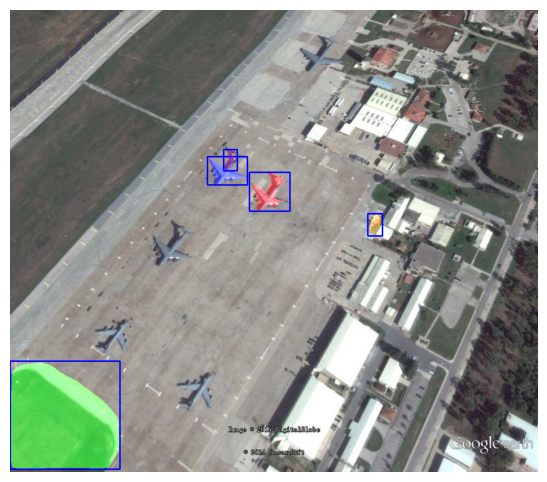

Processing /content/dataset/images/val/playground_367.jpg


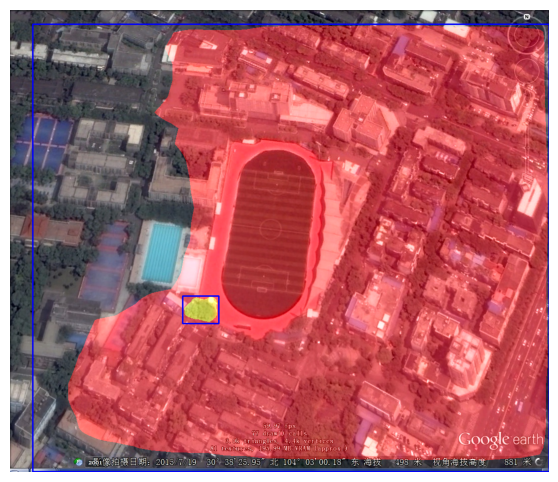

Processing /content/dataset/images/val/overpass_321.jpg


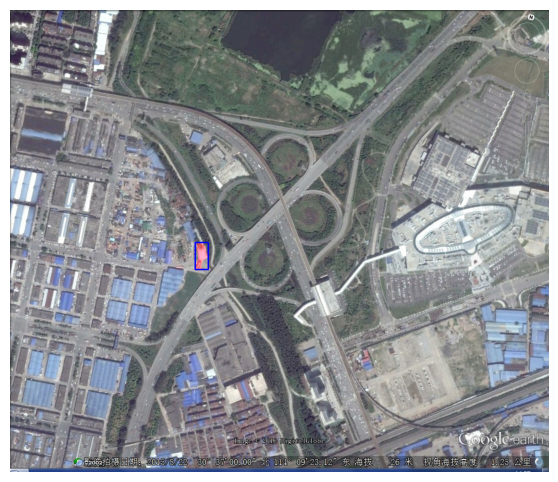

In [ ]:
# Process all images in train and val folders
for folder in [train_folder, val_folder]:
    image_files = get_image_files(folder)
    print(f"Processing {len(image_files)} images from {folder}...\n")
    for image_path in image_files[:5]:  # Limit to first 5 images per folder for now
        print(f"Processing {image_path}")
        predictions = predict(image_path)
        show_predictions(image_path, predictions)

# Experiment 3.1

In [ ]:
### **Step 1: Setup YOLOv5**
!git clone https://github.com/ultralytics/yolov5.git
%cd yolov5
!pip install -r requirements.txt

Cloning into 'yolov5'...
remote: Enumerating objects: 17270, done.
remote: Counting objects: 100% (1/1), done.
remote: Total 17270 (delta 0), reused 0 (delta 0), pack-reused 17269 (from 2)
Receiving objects: 100% (17270/17270), 16.12 MiB | 31.02 MiB/s, done.
Resolving deltas: 100% (11858/11858), done.
/content/yolov5
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.6/207.6 kB 5.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 914.7/914.7 kB 22.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.8/62.8 kB 2.8 MB/s eta 0:00:00


In [ ]:
# Install necessary libraries
!pip install ultralytics opencv-python numpy pandas
import os
import cv2
import numpy as np
import pandas as pd
import zipfile
import torch
from ultralytics import YOLO
import matplotlib.pyplot as plt

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


In [ ]:
# Unzip training and testing datasets
train_zip_path = "/content/drive/MyDrive/training_images-20250210T052334Z-001.zip"
test_zip_path = "/content/drive/MyDrive/testing_images-20250210T052334Z-001.zip"
train_extract_path = "/content/training_images"
test_extract_path = "/content/testing_images"

In [ ]:
# Extract files
for zip_path, extract_path in [(train_zip_path, train_extract_path), (test_zip_path, test_extract_path)]:
    with zipfile.ZipFile(zip_path, 'r') as zip_ref:
        zip_ref.extractall(extract_path)

In [ ]:
# Adjust paths to match extracted structure
train_extract_path = "/content/training_images"
test_extract_path = "/content/testing_images"

In [ ]:
# Load bounding box data
bbox_csv_path = "/content/drive/MyDrive/train_solution_bounding_boxes (1).csv"
df_bboxes = pd.read_csv(bbox_csv_path)

In [ ]:
df_bboxes.head()

,image,xmin,ymin,xmax,ymax
0,vid_4_1000.jpg,281.259045,187.035071,327.727931,223.225547
1,vid_4_10000.jpg,15.163531,187.035071,120.329957,236.430180
2,vid_4_10040.jpg,239.192475,176.764801,361.968162,236.430180
3,vid_4_10020.jpg,496.483358,172.363256,630.020260,231.539575
4,vid_4_10060.jpg,16.630970,186.546010,132.558611,238.386422


In [ ]:
# Load YOLOv5 model (pre-trained)
model = YOLO('yolov5s.pt')

PRO TIP 💡 Replace 'model=yolov5s.pt' with new 'model=yolov5su.pt'.
YOLOv5 'u' models are trained with https://github.com/ultralytics/ultralytics and feature improved performance vs standard YOLOv5 models trained with https://github.com/ultralytics/yolov5.



In [ ]:
# Function to draw bounding boxes
def draw_bounding_boxes(image_path, df_bboxes):
    image_name = os.path.basename(image_path)
    image = cv2.imread(image_path)
    # Check if image was loaded successfully
    if image is None:
        print(f"Error: Could not load image at path: {image_path}")
        return  # Exit the function if image loading failed
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    # Get bounding boxes for the image
    boxes = df_bboxes[df_bboxes['image'] == image_name]
    for _, row in boxes.iterrows():
        xmin, ymin, xmax, ymax = int(row['xmin']), int(row['ymin']), int(row['xmax']), int(row['ymax'])
        cv2.rectangle(image, (xmin, ymin), (xmax, ymax), (255, 0, 0), 2)
    plt.imshow(image)
    plt.axis('off')
    plt.show()

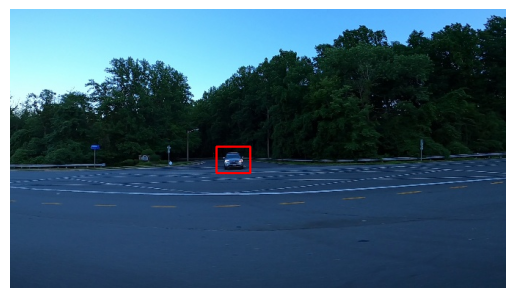

In [ ]:
# Test drawing bounding boxes on one training image
sample_image_path = os.path.join(train_extract_path, "training_images", df_bboxes.iloc[0]['image'])
draw_bounding_boxes(sample_image_path, df_bboxes)

In [ ]:
# Perform YOLO object detection on test images
def detect_objects(image_path, model):
    results = model(image_path)
    results[0].show()


image 1/1 /content/testing_images/testing_images/vid_5_26660.jpg: 384x640 1 car, 136.4ms
Speed: 2.0ms preprocess, 136.4ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)


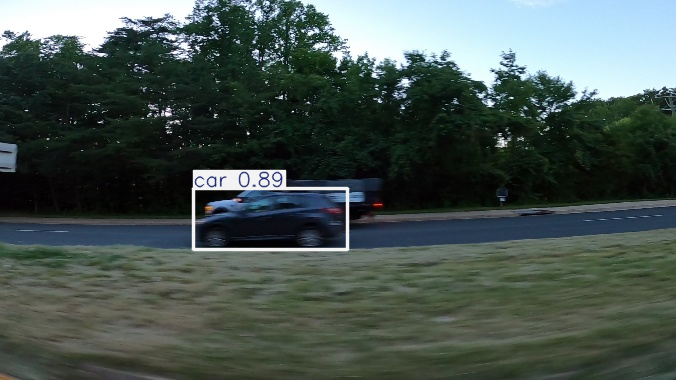

In [ ]:
# Test YOLO detection on one test image
test_image_path = os.path.join(test_extract_path, "testing_images", os.listdir(os.path.join(test_extract_path, "testing_images"))[0])
detect_objects(test_image_path, model)

# Experiment 3.2

In [ ]:
!pip install ultralytics -q

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 914.7/914.7 kB 12.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 4.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 56.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 41.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 24.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 5.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 7.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 6.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 16.5 MB/s eta 0:00:00


In [ ]:
# Object Detecion
import cv2
from ultralytics import YOLO
#plots
import matplotlib.pyplot as plt
import seaborn as sns

#basics
import pandas as pd
import numpy as np
import os
import subprocess

from tqdm.notebook import tqdm

# Display image and videos
import IPython
from IPython.display import Video, display
%matplotlib inline

In [ ]:
import os, time, random
import numpy as np
import pandas as pd
import cv2, torch
from tqdm.auto import tqdm
import shutil as sh

from IPython.display import Image, clear_output
import matplotlib.pyplot as plt


In [ ]:
!git clone https://github.com/ultralytics/yolov5  # clone repo
!pip install -U pycocotools
!pip install -qr yolov5/requirements.txt  # install dependencies
!cp yolov5/requirements.txt ./

fatal: destination path 'yolov5' already exists and is not an empty directory.


In [ ]:
from google.colab import drive
drive.mount('/content/drive/')

Drive already mounted at /content/drive/; to attempt to forcibly remount, call drive.mount("/content/drive/", force_remount=True).


In [ ]:
!ls /content/drive/MyDrive/data

 testing_images   training_images  'train_solution_bounding_boxes (1).csv'


In [ ]:
img_h, img_w, num_channels = (380, 676, 3)
df = pd.read_csv('/content/drive/MyDrive/data/train_solution_bounding_boxes (1).csv')
df.rename(columns={'image':'image_id'}, inplace=True)
df['image_id'] = df['image_id'].apply(lambda x: x.split('.')[0])
df['x_center'] = (df['xmin'] + df['xmax'])/2
df['y_center'] = (df['ymin'] + df['ymax'])/2
df['w'] = df['xmax'] - df['xmin']
df['h'] = df['ymax'] - df['ymin']
df['classes'] = 0
df['x_center'] = df['x_center']/img_w
df['w'] = df['w']/img_w
df['y_center'] = df['y_center']/img_h
df['h'] = df['h']/img_h
df.head()

,image_id,xmin,ymin,xmax,ymax,x_center,y_center,w,h,classes
0,vid_4_1000,281.259045,187.035071,327.727931,223.225547,0.450434,0.539817,0.068741,0.095238,0
1,vid_4_10000,15.163531,187.035071,120.329957,236.430180,0.100217,0.557191,0.155572,0.129987,0
2,vid_4_10040,239.192475,176.764801,361.968162,236.430180,0.444645,0.543678,0.181621,0.157014,0
3,vid_4_10020,496.483358,172.363256,630.020260,231.539575,0.833213,0.531451,0.197540,0.155727,0
4,vid_4_10060,16.630970,186.546010,132.558611,238.386422,0.110347,0.559122,0.171491,0.136422,0


In [ ]:
index = list(set(df.image_id))
image = random.choice(index)
print("Image ID: %s"%(image))
img = cv2.imread(f'/content/drive/MyDrive/data/training_images/{image}.jpg')

img.shape


Image ID: vid_4_14440


(380, 676, 3)

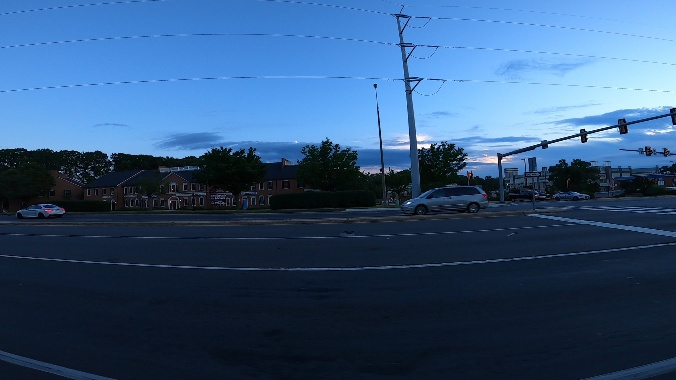

In [ ]:
image = random.choice(index)
Image(filename=f'/content/drive/MyDrive/data/training_images/{image}.jpg',width=600)

In [ ]:
source = 'training_images'
if True:
    for fold in [0]:
        val_index = index[len(index)*fold//5:len(index)*(fold+1)//5]
        for name,mini in tqdm(df.groupby('image_id')):
            if name in val_index:
                path2save = 'val2017/'
            else:
                path2save = 'train2017/'
            if not os.path.exists('/tmp/convertor/fold{}/labels/'.format(fold)+path2save):
                os.makedirs('/tmp/convertor/fold{}/labels/'.format(fold)+path2save)
            with open('/tmp/convertor/fold{}/labels/'.format(fold)+path2save+name+".txt", 'w+') as f:
                row = mini[['classes','x_center','y_center','w','h']].astype(float).values
                row = row.astype(str)
                for j in range(len(row)):
                    text = ' '.join(row[j])
                    f.write(text)
                    f.write("\n")
            if not os.path.exists('/tmp/convertor/fold{}/images/{}'.format(fold,path2save)):
                os.makedirs('/tmp/convertor/fold{}/images/{}'.format(fold,path2save))
            sh.copy("/content/drive/MyDrive/data/{}/{}.jpg".format(source,name),'/tmp/convertor/fold{}/images/{}/{}.jpg'.format(fold,path2save,name))

  0%|          | 0/355 [00:00<?, ?it/s]

In [ ]:
!python yolov5/detect.py --weights yolov5/yolov5s.pt --img 676 --conf 0.4 --source /content/drive/MyDrive/data/testing_images

detect: weights=['yolov5/yolov5s.pt'], source=/content/drive/MyDrive/data/testing_images, data=yolov5/data/coco128.yaml, imgsz=[676, 676], conf_thres=0.4, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_format=0, save_csv=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=yolov5/runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-398-g5cdad892 Python-3.11.11 torch-2.5.1+cu124 CPU

100% 14.1M/14.1M [00:00<00:00, 113MB/s] 

Fusing layers... 
YOLOv5s summary: 213 layers, 7225885 parameters, 0 gradients, 16.4 GFLOPs
WARNING ⚠️ --img-size [676, 676] must be multiple of max stride 32, updating to [704, 704]
image 1/175 /content/drive/.shortcut-targets-by-id/1arPa_lfVXnSvGRT-CGrufg3zMSJxqBca/data/testing_images/vid_5_25100.jpg: 416x704 (no detections), 333.5ms
image 2/175 /content/driv

In [ ]:
predicted_files = []
for (dirpath, dirnames, filenames) in os.walk("/content/yolov5/runs/detect/exp"):
    predicted_files.extend(filenames)

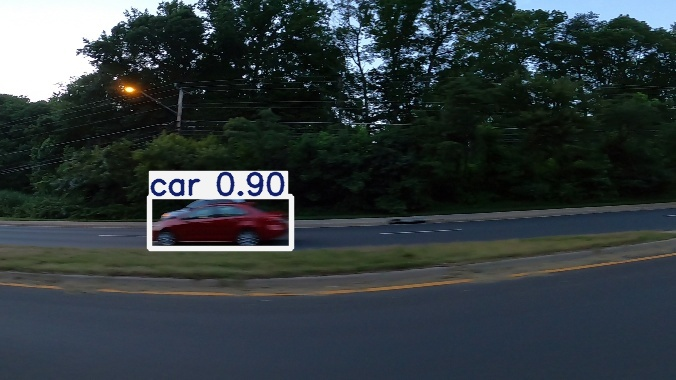

In [ ]:
Image(filename=f'/content/yolov5/runs/detect/exp/{random.choice(predicted_files)}')

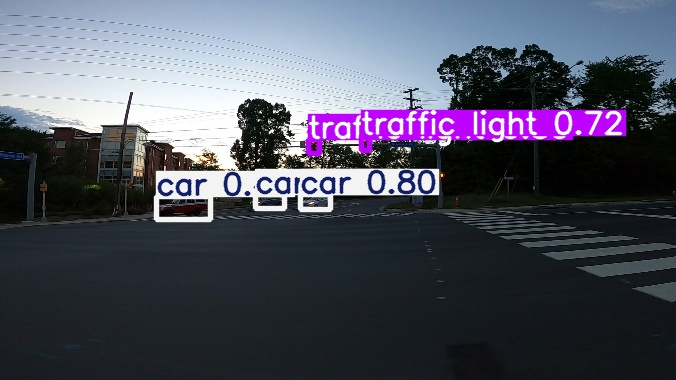

In [ ]:
Image(filename=f'/content/yolov5/runs/detect/exp/{random.choice(predicted_files)}')

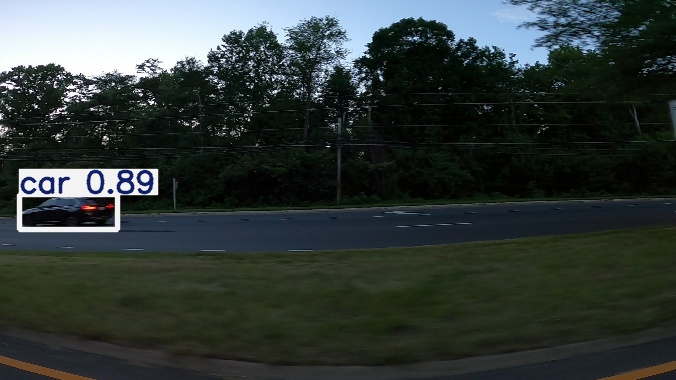

In [ ]:
Image(filename=f'/content/yolov5/runs/detect/exp/{random.choice(predicted_files)}')

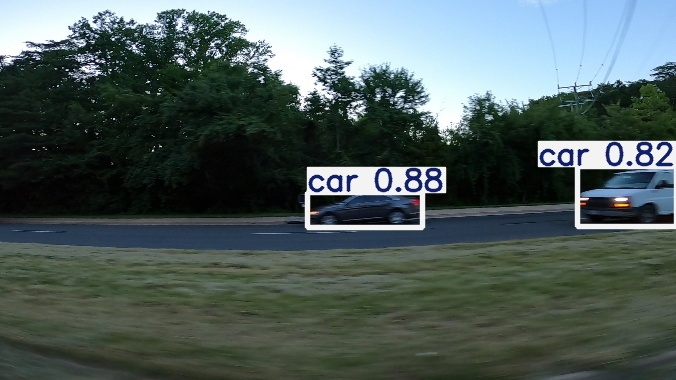

In [ ]:
Image(filename=f'/content/yolov5/runs/detect/exp/{random.choice(predicted_files)}')

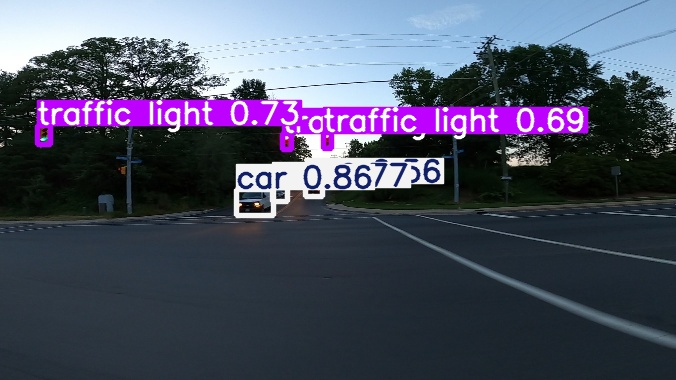

In [ ]:
Image(filename=f'/content/yolov5/runs/detect/exp/{random.choice(predicted_files)}')

In [ ]:
import cv2
import os

# Path to detected frames
predicted_dir = "/content/yolov5/runs/detect/exp"
output_video_path = "/content/detected_output.mp4"

# Get list of detected images
predicted_files = sorted([f for f in os.listdir(predicted_dir) if f.endswith('.jpg')])

# Read the first image to get dimensions
first_img = cv2.imread(os.path.join(predicted_dir, predicted_files[0]))
height, width, layers = first_img.shape

# Define video writer
fourcc = cv2.VideoWriter_fourcc(*'mp4v')  # Codec
video = cv2.VideoWriter(output_video_path, fourcc, 10, (width, height))

# Add frames to video
for file in predicted_files:
    frame = cv2.imread(os.path.join(predicted_dir, file))
    video.write(frame)

video.release()
print("✅ Video saved at:", output_video_path)


✅ Video saved at: /content/detected_output.mp4


In [ ]:
import imageio
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML
!pip install imageio[ffmpeg] # Install the ffmpeg plugin for imageio

In [ ]:
def display_video(video):
    fig = plt.figure(figsize=(5, 5))  # Display size specification
    mov = []
    for i in range(len(video)):
        img = plt.imshow(video[i], animated=True)
        plt.axis('off')
        mov.append([img])
    # Animation Creation
    anime = animation.ArtistAnimation(fig, mov, interval=50, repeat_delay=1000)
    plt.close()
    return anime

In [ ]:
# Set frame skipping rate
frame_skip = 1  # Change this to adjust how many frames to skip

In [ ]:
# Read the video and apply frame skipping
reader = imageio.get_reader('/content/detected_output.mp4')  # Use your tracked video path
video = []

In [ ]:
# Iterate through frames and append only the selected frames
for i, im in enumerate(reader):
    if i % frame_skip == 0:  # Only keep every `frame_skip` frame
        video.append(im)

In [ ]:
print('\033[1m' + 'Output Video' + '\033[0m')
# Display the skipped frame video
HTML(display_video(video).to_html5_video())

Output Video


In [ ]:
# Loop through different confidence values
for conf in [0.2, 0.5, 0.7]:
    !python yolov5/detect.py --weights yolov5/yolov5s.pt --img 676 --conf {conf} --source /content/drive/MyDrive/data/testing_images
    print(f'Results with confidence threshold {conf}')

# Loop through different YOLOv5 models
for model in ['yolov5s.pt', 'yolov5m.pt']:
    !python yolov5/detect.py --weights yolov5/{model} --img 676 --conf 0.4 --source /content/drive/MyDrive/data/testing_images
    print(f'Results using model {model}')

# Loop through different image sizes
for img_size in [320, 416, 608]:
    !python yolov5/detect.py --weights yolov5/yolov5s.pt --img {img_size} --conf 0.4 --source /content/drive/MyDrive/data/testing_images
    print(f'Results with image size {img_size}')

detect: weights=['yolov5/yolov5s.pt'], source=/content/drive/MyDrive/data/testing_images, data=yolov5/data/coco128.yaml, imgsz=[676, 676], conf_thres=0.2, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_format=0, save_csv=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=yolov5/runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-398-g5cdad892 Python-3.11.11 torch-2.5.1+cu124 CPU

Fusing layers... 
YOLOv5s summary: 213 layers, 7225885 parameters, 0 gradients, 16.4 GFLOPs
WARNING ⚠️ --img-size [676, 676] must be multiple of max stride 32, updating to [704, 704]
image 1/175 /content/drive/.shortcut-targets-by-id/1arPa_lfVXnSvGRT-CGrufg3zMSJxqBca/data/testing_images/vid_5_25100.jpg: 416x704 (no detections), 322.9ms
image 2/175 /content/drive/.shortcut-targets-by-id/1arPa_lfVXnSvGRT

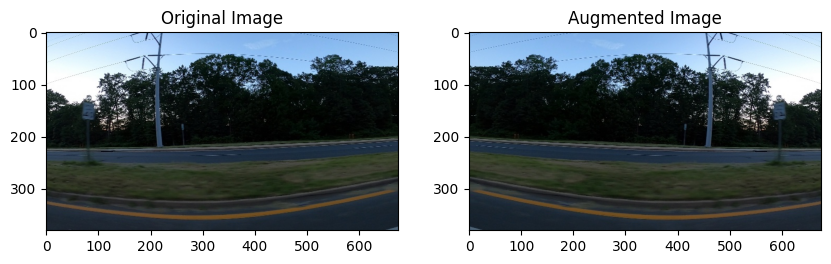

In [ ]:
# Perform image augmentation (Horizontal Flip) and run YOLOv5 detection
from PIL import Image
import torchvision.transforms as T

transform = T.RandomHorizontalFlip(p=1)  # Flip the image with probability 1
img_path = '/content/yolov5/runs/detect/exp/vid_5_25180.jpg'
img = Image.open(img_path)

aug_img = transform(img)

# Displaying img and aug_img side by side
fig, axs = plt.subplots(1, 2, figsize=(10, 5))
axs[0].imshow(img)
axs[0].set_title('Original Image')
axs[1].imshow(aug_img)
axs[1].set_title('Augmented Image')
plt.show()


# Experiment 4

In [ ]:
!pip install kagglehub
import kagglehub
import os
import zipfile
import shutil

In [ ]:
# Step 1: Download the dataset
dataset_path = kagglehub.dataset_download("stoicstatic/face-recognition-dataset")
print("Dataset downloaded at:", dataset_path)

100%|██████████| 181M/181M [00:09<00:00, 20.1MB/s]

Extracting files...


Dataset downloaded at: /root/.cache/kagglehub/datasets/stoicstatic/face-recognition-dataset/versions/10


In [ ]:
# Step 2: Move downloaded files to the target folder
extracted_folder = "/content/face_recognition_dataset"
# Ensure the extracted folder exists
os.makedirs(extracted_folder, exist_ok=True)

In [ ]:
# Instead of extracting a zip, move downloaded content
if os.path.isdir(dataset_path):
    for item in os.listdir(dataset_path):
        s = os.path.join(dataset_path, item)
        d = os.path.join(extracted_folder, item)
        if os.path.isdir(s):
            shutil.copytree(s, d, False, None)
        else:
            shutil.copy2(s, d)
    print("Dataset moved to:", extracted_folder)
else:
    print("Warning: Dataset path does not point to a directory or a zip file. Skipping.")

Dataset moved to: /content/face_recognition_dataset


In [ ]:
# Step 3: List dataset contents
if os.path.exists(extracted_folder):
    print("Dataset Structure:", os.listdir(extracted_folder))
else:
    print("Error: Extracted dataset folder not found. Check the download and extraction steps.")

Dataset Structure: ['Extracted Faces', 'Face Data']


In [ ]:
import cv2
import numpy as np
import tensorflow as tf
import os
from tensorflow.keras.preprocessing.image import load_img, img_to_array
from itertools import combinations
import random

In [ ]:
# Define image size
IMG_SIZE = (100, 100)

In [ ]:
# Paths
dataset_path = "/content/face_recognition_dataset/Extracted Faces/Extracted Faces"
categories = os.listdir(dataset_path)

In [ ]:
import numpy as np
import os
import cv2

In [ ]:
img_size = (100, 100)  # Adjust this based on your earlier preprocessing

In [ ]:
# Function to load images and create pairs
def load_images_and_create_pairs(dataset_path):
    X, y = [], []
    class_folders = sorted(os.listdir(dataset_path))  # Sorting to maintain order
    for label, folder in enumerate(class_folders):
        folder_path = os.path.join(dataset_path, folder)
        if os.path.isdir(folder_path):
            images = [cv2.imread(os.path.join(folder_path, img), cv2.IMREAD_GRAYSCALE)
                      for img in os.listdir(folder_path) if img.endswith('.jpg')]

            images = [cv2.resize(img, img_size) for img in images if img is not None]
            images = np.array(images).reshape(-1, 100, 100, 1)  # Ensure shape consistency

            for i in range(len(images) - 1):
                X.append([images[i], images[i + 1]])  # Creating positive pairs
                y.append(1)
    return np.array(X), np.array(y)

In [ ]:
# Re-run preprocessing
X_train, y_train = load_images_and_create_pairs(dataset_path)

In [ ]:
# Save the data
np.save("/content/X_train.npy", X_train)
np.save("/content/y_train.npy", y_train)

In [ ]:
X_train = np.load("/content/X_train.npy")
y_train = np.load("/content/y_train.npy")
print("Data loaded successfully:", X_train.shape, y_train.shape)

Data loaded successfully: (4783, 2, 100, 100, 1) (4783,)


In [ ]:
import tensorflow as tf
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Conv2D, MaxPooling2D, Flatten, Dense, Lambda
import tensorflow.keras.backend as K

In [ ]:
# Define the shared CNN model
def build_base_cnn(input_shape=(100, 100, 1)):
    inputs = Input(shape=input_shape)
    x = Conv2D(64, (3, 3), activation='relu', padding='same')(inputs)
    x = MaxPooling2D(pool_size=(2, 2))(x)
    x = Conv2D(128, (3, 3), activation='relu', padding='same')(x)
    x = MaxPooling2D(pool_size=(2, 2))(x)
    x = Conv2D(256, (3, 3), activation='relu', padding='same')(x)
    x = MaxPooling2D(pool_size=(2, 2))(x)
    x = Flatten()(x)
    x = Dense(256, activation='relu')(x)  # Feature vector
    model = Model(inputs, x)
    return model

In [ ]:
# Build base CNN
base_network = build_base_cnn()
base_network.summary()

Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 100, 100, 1)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d (Conv2D)                      │ (None, 100, 100, 64)        │             640 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d (MaxPooling2D)         │ (None, 50, 50, 64)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_1 (Conv2D)                    │ (None, 50, 50, 128)         │          73,856 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_1 (MaxPooling2D)       │ (None, 25, 25, 128)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_2 (Conv2D)                    │ (None, 25, 25, 256)         │         295,168 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_2 (MaxPooling2D)       │ (None, 12, 12, 256)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten (Flatten)                    │ (None, 36864)               │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 256)                 │       9,437,440 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 9,807,104 (37.41 MB)

 Trainable params: 9,807,104 (37.41 MB)

 Non-trainable params: 0 (0.00 B)

In [ ]:
# Input layers for the two images
input_a = Input(shape=(100, 100, 1))
input_b = Input(shape=(100, 100, 1))

In [ ]:
# Extract features using the shared CNN
feature_a = base_network(input_a)
feature_b = base_network(input_b)

In [ ]:
# Compute the Euclidean distance between the two feature vectors
def euclidean_distance(vectors):
    x, y = vectors
    return K.sqrt(K.sum(K.square(x - y), axis=1, keepdims=True))

In [ ]:
distance = Lambda(euclidean_distance)([feature_a, feature_b])

In [ ]:
# Fully connected layer for classification
output = Dense(1, activation="sigmoid")(distance)

In [ ]:
# Define the Siamese network model
siamese_model = Model(inputs=[input_a, input_b], outputs=output)
siamese_model.summary()

Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_1             │ (None, 100, 100, 1)    │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ input_layer_2             │ (None, 100, 100, 1)    │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ functional (Functional)   │ (None, 256)            │      9,807,104 │ input_layer_1[0][0],   │
│                           │                        │                │ input_layer_2[0][0]    │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ lambda (Lambda)           │ (None, 1)              │              0 │ functional[0][0],      │
│                           │                        │                │ functional[1][0]       │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_1 (Dense)           │ (None, 1)              │              2 │ lambda[0][0]           │
└───────────────────────────┴────────────────────────┴────────────────┴────────────────────────┘

 Total params: 9,807,106 (37.41 MB)

 Trainable params: 9,807,106 (37.41 MB)

 Non-trainable params: 0 (0.00 B)

In [ ]:
# Compile the model
siamese_model.compile(loss="binary_crossentropy", optimizer="adam", metrics=["accuracy"])

In [ ]:
# Train the model
history = siamese_model.fit([X_train[:, 0], X_train[:, 1]], y_train,
                            batch_size=32, epochs=10, validation_split=0.4)

Epoch 1/10
90/90 ━━━━━━━━━━━━━━━━━━━━ 24s 125ms/step - accuracy: 1.0000 - loss: 1.6091e-09 - val_accuracy: 1.0000 - val_loss: 5.0026e-09
Epoch 2/10
90/90 ━━━━━━━━━━━━━━━━━━━━ 5s 59ms/step - accuracy: 1.0000 - loss: 2.5070e-11 - val_accuracy: 1.0000 - val_loss: 4.5477e-09
Epoch 3/10
90/90 ━━━━━━━━━━━━━━━━━━━━ 10s 56ms/step - accuracy: 1.0000 - loss: 2.6346e-11 - val_accuracy: 1.0000 - val_loss: 4.2674e-09
Epoch 4/10
90/90 ━━━━━━━━━━━━━━━━━━━━ 5s 56ms/step - accuracy: 1.0000 - loss: 1.9284e-11 - val_accuracy: 1.0000 - val_loss: 4.0060e-09
Epoch 5/10
90/90 ━━━━━━━━━━━━━━━━━━━━ 5s 55ms/step - accuracy: 1.0000 - loss: 1.3871e-11 - val_accuracy: 1.0000 - val_loss: 3.7744e-09
Epoch 6/10
90/90 ━━━━━━━━━━━━━━━━━━━━ 5s 56ms/step - accuracy: 1.0000 - loss: 1.4623e-11 - val_accuracy: 1.0000 - val_loss: 3.5641e-09
Epoch 7/10
90/90 ━━━━━━━━━━━━━━━━━━━━ 5s 60ms/step - accuracy: 1.0000 - loss: 1.8772e-11 - val_accuracy: 1.0000 - val_loss: 3.3957e-09
Epoch 8/10
90/90 ━━━━━━━━━━━━━━━━━━━━ 10s 58ms/step 

In [ ]:
import random
def create_test_pairs(dataset_path, num_pairs=25):
    """Create test pairs of images (similar and dissimilar)."""
    test_X, test_y = [], []
    class_folders = sorted(os.listdir(dataset_path))  # Sorted class names
    # Creating positive pairs
    for folder in class_folders:
        folder_path = os.path.join(dataset_path, folder)
        if os.path.isdir(folder_path):
            images = [cv2.imread(os.path.join(folder_path, img), cv2.IMREAD_GRAYSCALE)
                      for img in os.listdir(folder_path) if img.endswith('.jpg')]
            images = [cv2.resize(img, img_size) for img in images if img is not None]
            images = np.array(images).reshape(-1, 100, 100, 1)
            if len(images) > 1:
                for _ in range(num_pairs):  # Select random similar pairs
                    i, j = random.sample(range(len(images)), 2)
                    test_X.append([images[i], images[j]])
                    test_y.append(1)  # Similar
    # Creating negative pairs
    for _ in range(num_pairs):
        cls1, cls2 = random.sample(class_folders, 2)  # Pick two different classes
        img1 = cv2.imread(os.path.join(dataset_path, cls1, random.choice(os.listdir(os.path.join(dataset_path, cls1)))),
                          cv2.IMREAD_GRAYSCALE)
        img2 = cv2.imread(os.path.join(dataset_path, cls2, random.choice(os.listdir(os.path.join(dataset_path, cls2)))),
                          cv2.IMREAD_GRAYSCALE)
        if img1 is not None and img2 is not None:
            img1 = cv2.resize(img1, img_size).reshape(100, 100, 1)
            img2 = cv2.resize(img2, img_size).reshape(100, 100, 1)
            test_X.append([img1, img2])
            test_y.append(0)  # Dissimilar
    return np.array(test_X), np.array(test_y)

In [ ]:
# Generate test data
X_test, y_test = create_test_pairs(dataset_path)

In [ ]:
# Save test set
np.save("/content/X_test.npy", X_test)

In [ ]:
np.save("/content/y_test.npy", y_test)

In [ ]:
# Load the test data
X_test = np.load("/content/X_test.npy")
y_test = np.load("/content/y_test.npy")

In [ ]:
# Evaluate model on test data
test_loss, test_accuracy = siamese_model.evaluate([X_test[:, 0], X_test[:, 1]], y_test)

1036/1036 ━━━━━━━━━━━━━━━━━━━━ 19s 18ms/step - accuracy: 1.0000 - loss: 9.6588e-05


In [ ]:
# Print the results
print(f"Test Loss: {test_loss:.4f}")
print(f"Test Accuracy: {test_accuracy:.4f}")

Test Loss: 0.0359
Test Accuracy: 0.9992


In [ ]:
import tensorflow.keras.backend as K
def cosine_similarity(vectors):
    x, y = vectors
    x_norm = K.l2_normalize(x, axis=1)  # Normalize vectors
    y_norm = K.l2_normalize(y, axis=1)
    return K.sum(x_norm * y_norm, axis=1, keepdims=True)  # Compute cosine similarity

In [ ]:
# Apply updated function
distance_cosine = Lambda(cosine_similarity)([feature_a, feature_b])

In [ ]:
# Fully connected layer for classification
output_cosine = Dense(1, activation="sigmoid")(distance_cosine)

In [ ]:
# Define the updated Siamese model
siamese_model_cosine = Model(inputs=[input_a, input_b], outputs=output_cosine)
siamese_model_cosine.compile(loss="binary_crossentropy", optimizer="adam", metrics=["accuracy"])

In [ ]:
# Train the model with cosine similarity
history_cosine = siamese_model_cosine.fit([X_train[:, 0], X_train[:, 1]], y_train,
                                          batch_size=32, epochs=10, validation_split=0.4)

Epoch 1/10
90/90 ━━━━━━━━━━━━━━━━━━━━ 12s 93ms/step - accuracy: 0.3413 - loss: 0.8621 - val_accuracy: 1.0000 - val_loss: 0.6519
Epoch 2/10
90/90 ━━━━━━━━━━━━━━━━━━━━ 6s 60ms/step - accuracy: 1.0000 - loss: 0.6421 - val_accuracy: 1.0000 - val_loss: 0.6129
Epoch 3/10
90/90 ━━━━━━━━━━━━━━━━━━━━ 11s 65ms/step - accuracy: 1.0000 - loss: 0.6035 - val_accuracy: 1.0000 - val_loss: 0.5757
Epoch 4/10
90/90 ━━━━━━━━━━━━━━━━━━━━ 10s 60ms/step - accuracy: 1.0000 - loss: 0.5668 - val_accuracy: 1.0000 - val_loss: 0.5407
Epoch 5/10
90/90 ━━━━━━━━━━━━━━━━━━━━ 5s 60ms/step - accuracy: 1.0000 - loss: 0.5324 - val_accuracy: 1.0000 - val_loss: 0.5079
Epoch 6/10
90/90 ━━━━━━━━━━━━━━━━━━━━ 5s 57ms/step - accuracy: 1.0000 - loss: 0.5001 - val_accuracy: 1.0000 - val_loss: 0.4772
Epoch 7/10
90/90 ━━━━━━━━━━━━━━━━━━━━ 5s 60ms/step - accuracy: 1.0000 - loss: 0.4700 - val_accuracy: 1.0000 - val_loss: 0.4486
Epoch 8/10
90/90 ━━━━━━━━━━━━━━━━━━━━ 10s 60ms/step - accuracy: 1.0000 - loss: 0.4418 - val_accuracy: 1.0000

In [ ]:
# Evaluate the model with cosine similarity
test_loss_cosine, test_accuracy_cosine = siamese_model_cosine.evaluate([X_test[:, 0], X_test[:, 1]], y_test)

1036/1036 ━━━━━━━━━━━━━━━━━━━━ 18s 17ms/step - accuracy: 1.0000 - loss: 0.3739


In [ ]:
# Print results
print(f"Test Loss (Cosine): {test_loss_cosine:.4f}")
print(f"Test Accuracy (Cosine): {test_accuracy_cosine:.4f}")

Test Loss (Cosine): 0.3745
Test Accuracy (Cosine): 0.9992


# Experiment 5

In [ ]:
!unzip '/content/Copy of images.zip'

Archive:  /content/Copy of images.zip
  inflating: data/24301.jpg          
  inflating: data/24309.jpg          
  inflating: data/24314.jpg          
  inflating: data/24287.jpg          
  inflating: data/24269.jpg          
  inflating: data/24300.jpg          
  inflating: data/24266.jpg          
  inflating: data/24325.jpg          
  inflating: data/24328.jpg          
  inflating: data/24304.jpg          
  inflating: data/24295.jpg          
  inflating: data/24334.jpg          
  inflating: data/24322.jpg          
  inflating: data/24329.jpg          
  inflating: data/24320.jpg          
  inflating: data/24279.jpg          
  inflating: data/24315.jpg          
  inflating: data/24321.jpg          
  inflating: data/24317.jpg          
  inflating: data/24282.jpg          
  inflating: data/24313.jpg          
  inflating: data/24267.jpg          
  inflating: data/24262.jpg          
  inflating: data/24268.jpg          
  inflating: data/24265.jpg          
  inflating:

In [ ]:
import os
import numpy as np
import tensorflow as tf
from tensorflow.keras.layers import Conv2D, Conv2DTranspose, BatchNormalization, LeakyReLU, Flatten, Dense, Reshape, Input
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam
import matplotlib.pyplot as plt
from tensorflow.keras.preprocessing.image import load_img, img_to_array

In [ ]:
# Load and preprocess dataset
def load_dataset(data_path, img_size=(120, 120), sample_size=500):
    image_files = [os.path.join(data_path, f) for f in os.listdir(data_path)[:sample_size]]
    images = [img_to_array(load_img(img, target_size=img_size)) / 255.0 for img in image_files]
    images = np.array(images)
    grayscale_images = np.expand_dims(np.mean(images, axis=-1), axis=-1)
    return grayscale_images, images

In [ ]:
# Define the Generator
def build_generator():
    input_layer = Input(shape=(120, 120, 1))
    x = Conv2D(64, (3, 3), padding='same', activation='relu')(input_layer)
    x = BatchNormalization()(x)
    x = Conv2DTranspose(128, (3, 3), strides=(1, 1), padding='same', activation='relu')(x)
    x = BatchNormalization()(x)
    x = Conv2D(64, (3, 3), padding='same', activation='relu')(x)
    x = BatchNormalization()(x)
    x = Conv2D(3, (3, 3), padding='same', activation='sigmoid')(x)
    return Model(input_layer, x, name='Generator')

In [ ]:
# Define the Discriminator
def build_discriminator():
    input_layer = Input(shape=(120, 120, 3))
    x = Conv2D(64, (3, 3), strides=(2, 2), padding='same')(input_layer)
    x = LeakyReLU(alpha=0.2)(x)
    x = Conv2D(128, (3, 3), strides=(2, 2), padding='same')(x)
    x = LeakyReLU(alpha=0.2)(x)
    x = Flatten()(x)
    x = Dense(1, activation='sigmoid')(x)
    return Model(input_layer, x, name='Discriminator')

In [ ]:
# Define the GAN
def build_gan(generator, discriminator):
    discriminator.trainable = False
    input_layer = Input(shape=(120, 120, 1))
    generated_image = generator(input_layer)
    validity = discriminator(generated_image)
    return Model(input_layer, validity, name='GAN')

In [ ]:
# Compile models
generator = build_generator()
discriminator = build_discriminator()

/usr/local/lib/python3.11/dist-packages/keras/src/layers/activations/leaky_relu.py:41: UserWarning: Argument `alpha` is deprecated. Use `negative_slope` instead.
  warnings.warn(


In [ ]:
# Summary of generator and discriminator
generator.summary()
print('')
discriminator.summary()

Model: "Generator"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 120, 120, 1)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d (Conv2D)                      │ (None, 120, 120, 64)        │             640 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization                  │ (None, 120, 120, 64)        │             256 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_transpose (Conv2DTranspose)   │ (None, 120, 120, 128)       │          73,856 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_1                │ (None, 120, 120, 128)       │             512 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_1 (Conv2D)                    │ (None, 120, 120, 64)        │          73,792 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_2                │ (None, 120, 120, 64)        │             256 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_2 (Conv2D)                    │ (None, 120, 120, 3)         │           1,731 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 151,043 (590.01 KB)

 Trainable params: 150,531 (588.01 KB)

 Non-trainable params: 512 (2.00 KB)

Model: "Discriminator"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer_1 (InputLayer)           │ (None, 120, 120, 3)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_3 (Conv2D)                    │ (None, 60, 60, 64)          │           1,792 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ leaky_re_lu (LeakyReLU)              │ (None, 60, 60, 64)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_4 (Conv2D)                    │ (None, 30, 30, 128)         │          73,856 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ leaky_re_lu_1 (LeakyReLU)            │ (None, 30, 30, 128)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten (Flatten)                    │ (None, 115200)              │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 1)                   │         115,201 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 190,849 (745.50 KB)

 Trainable params: 190,849 (745.50 KB)

 Non-trainable params: 0 (0.00 B)

In [ ]:
discriminator.compile(loss='binary_crossentropy', optimizer=Adam(0.0002, 0.5), metrics=['accuracy'])
gan = build_gan(generator, discriminator)
gan.compile(loss='binary_crossentropy', optimizer=Adam(0.0002, 0.5))

In [ ]:
# Train GAN
def train_gan(epochs=10000, batch_size=32, save_interval=500):
    grayscale_images, color_images = load_dataset('/content/data')
    for epoch in range(epochs):
        idx = np.random.randint(0, grayscale_images.shape[0], batch_size)
        real_images = color_images[idx]
        grayscale_batch = grayscale_images[idx]
        fake_images = generator.predict(grayscale_batch)
        d_loss_real = discriminator.train_on_batch(real_images, np.ones((batch_size, 1)))
        d_loss_fake = discriminator.train_on_batch(fake_images, np.zeros((batch_size, 1)))
        d_loss = 0.5 * np.add(d_loss_real, d_loss_fake)
        g_loss = gan.train_on_batch(grayscale_batch, np.ones((batch_size, 1)))
        if epoch % save_interval == 0:
            print(f"Epoch {epoch}, D Loss: {d_loss[0]}, G Loss: {g_loss}")

In [ ]:
# Run training
train_gan(epochs=10000, batch_size=32, save_interval=100)

Streaming output truncated to the last 5000 lines.
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step

In [ ]:
# Display results
def display_results():
    grayscale_images, color_images = load_dataset('/content/data', sample_size=5)
    idx = np.random.choice(range(grayscale_images.shape[0]), 5, replace=False)
    grayscale_images = grayscale_images[idx]
    color_images = color_images[idx]
    generated_images = generator.predict(grayscale_images)
    for i in range(5):
        plt.figure(figsize=(10, 3))
        plt.subplot(1, 3, 1)
        plt.imshow(grayscale_images[i].squeeze(), cmap='gray')
        plt.title("Grayscale Input")
        plt.axis('off')
        plt.subplot(1, 3, 2)
        plt.imshow(generated_images[i])
        plt.title("Generated Colorized Image")
        plt.axis('off')
        plt.subplot(1, 3, 3)
        plt.imshow(color_images[i])
        plt.title("Ground Truth")
        plt.axis('off')
        plt.show()

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


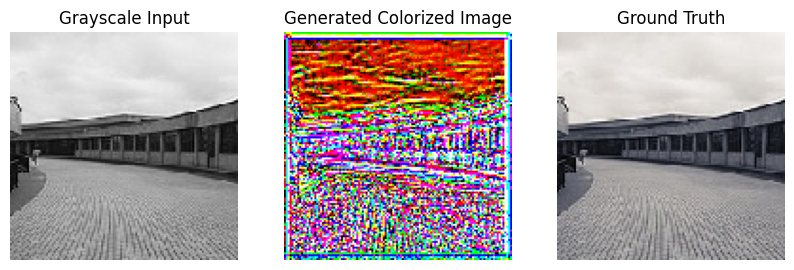

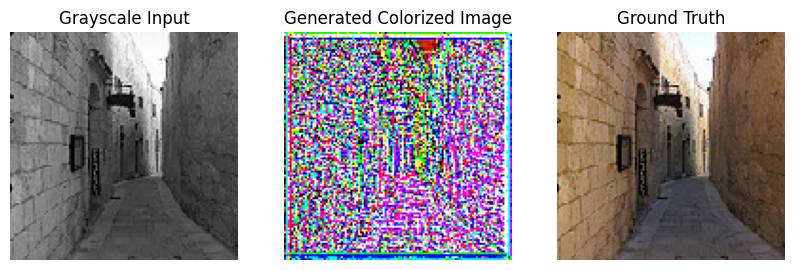

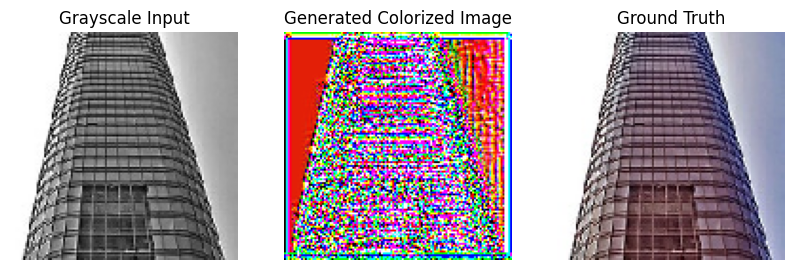

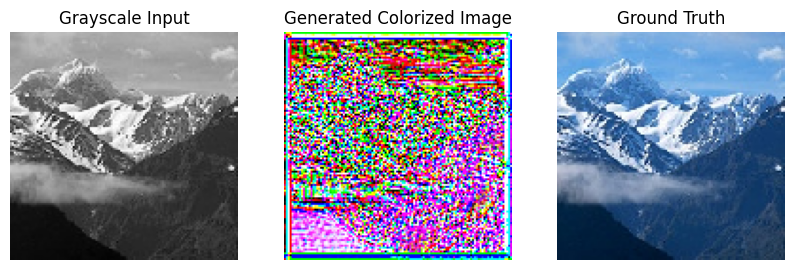

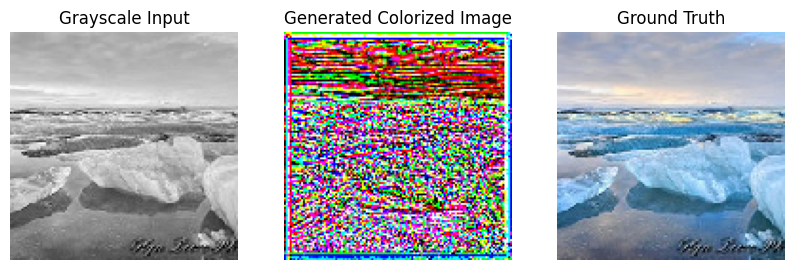

In [ ]:
# Show results
display_results()

# Experiment 6

In [ ]:
!pip install mit_semseg

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 46.9/46.9 kB 2.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 1.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 79.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 61.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 47.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 849.7 kB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 5.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 15.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 6.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 89.5 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Uninstallin

**PSPNet ADE20K Pipeline**

In [ ]:
import os, shutil, torch
from PIL import Image
import numpy as np
import matplotlib.pyplot as plt
from torchvision import transforms
from mit_semseg.config import cfg
from mit_semseg.models import ModelBuilder, SegmentationModule

In [ ]:
# 1️⃣ Clone fresh repo
os.chdir("/content")
if os.path.exists("semantic-segmentation-pytorch"):
    shutil.rmtree("semantic-segmentation-pytorch")
!git clone https://github.com/CSAILVision/semantic-segmentation-pytorch.git
os.chdir("semantic-segmentation-pytorch")

Cloning into 'semantic-segmentation-pytorch'...
remote: Enumerating objects: 1170, done.
remote: Total 1170 (delta 0), reused 0 (delta 0), pack-reused 1170 (from 1)
Receiving objects: 100% (1170/1170), 5.04 MiB | 19.04 MiB/s, done.
Resolving deltas: 100% (707/707), done.


In [ ]:
# 2️⃣ Install dependencies
!pip install -q yacs pyyaml tqdm matplotlib opencv-python pillow scipy torchvision

In [ ]:
# 3️⃣ Download ADE20K via official script
!chmod +x download_ADE20K.sh
!./download_ADE20K.sh

Streaming output truncated to the last 5000 lines.
  inflating: ./data/ADEChallengeData2016/annotations/training/ADE_train_00010086.png  
  inflating: ./data/ADEChallengeData2016/annotations/training/ADE_train_00002526.png  
  inflating: ./data/ADEChallengeData2016/annotations/training/ADE_train_00002954.png  
  inflating: ./data/ADEChallengeData2016/annotations/training/ADE_train_00007278.png  
  inflating: ./data/ADEChallengeData2016/annotations/training/ADE_train_00012415.png  
  inflating: ./data/ADEChallengeData2016/annotations/training/ADE_train_00012867.png  
  inflating: ./data/ADEChallengeData2016/annotations/training/ADE_train_00000612.png  
  inflating: ./data/ADEChallengeData2016/annotations/training/ADE_train_00016979.png  
  inflating: ./data/ADEChallengeData2016/annotations/training/ADE_train_00013255.png  
  inflating: ./data/ADEChallengeData2016/annotations/training/ADE_train_00013980.png  
  inflating: ./data/ADEChallengeData2016/annotations/training/ADE_train_0000105

In [ ]:
# 4️⃣ Fetch config, pretrained weights & color map
!mkdir -p config ckpt/pspnet data
!wget -q https://raw.githubusercontent.com/CSAILVision/semantic-segmentation-pytorch/master/config/ade20k-resnet50dilated-ppm_deepsup.yaml \
      -O config/ade20k-resnet50dilated-ppm_deepsup.yaml
!wget -q http://sceneparsing.csail.mit.edu/model/pytorch/ade20k-resnet50dilated-ppm_deepsup/encoder_epoch_20.pth \
      -P ckpt/pspnet
!wget -q http://sceneparsing.csail.mit.edu/model/pytorch/ade20k-resnet50dilated-ppm_deepsup/decoder_epoch_20.pth \
      -P ckpt/pspnet
!wget -q https://raw.githubusercontent.com/CSAILVision/semantic-segmentation-pytorch/master/data/color150.npy \
      -P data

In [ ]:
# 5️⃣ Load & override config
cfg.defrost()
cfg.merge_from_file("config/ade20k-resnet50dilated-ppm_deepsup.yaml")
cfg.MODEL.weights_encoder  = "ckpt/pspnet/encoder_epoch_20.pth"
cfg.MODEL.weights_decoder  = "ckpt/pspnet/decoder_epoch_20.pth"
cfg.DATASET.root_dataset   = os.path.join(os.getcwd(), "data", "ADEChallengeData2016")
cfg.DATASET.ignore_label   = getattr(cfg.DATASET, "ignore_label", 255)
cfg.DATASET.image_mean     = getattr(cfg.DATASET, "image_mean", [0.485,0.456,0.406])
cfg.DATASET.image_std      = getattr(cfg.DATASET, "image_std",  [0.229,0.224,0.225])
cfg.freeze()

In [ ]:
# 6️⃣ Build the PSPNet segmentation module
builder     = ModelBuilder()
net_encoder = builder.build_encoder(
    arch   = cfg.MODEL.arch_encoder,
    fc_dim = cfg.MODEL.fc_dim,
    weights= cfg.MODEL.weights_encoder
)
net_decoder = builder.build_decoder(
    arch      = cfg.MODEL.arch_decoder,
    fc_dim    = cfg.MODEL.fc_dim,
    num_class = cfg.DATASET.num_class,
    weights   = cfg.MODEL.weights_decoder
)
crit        = torch.nn.NLLLoss(ignore_index=cfg.DATASET.ignore_label)
segmentor   = SegmentationModule(net_encoder, net_decoder, crit)
device      = torch.device("cuda" if torch.cuda.is_available() else "cpu")
segmentor.to(device).eval()

Loading weights for net_encoder
Loading weights for net_decoder


SegmentationModule(
  (encoder): ResnetDilated(
    (conv1): Conv2d(3, 64, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (bn1): SynchronizedBatchNorm2d(64, eps=1e-05, momentum=0.001, affine=True, track_running_stats=True)
    (relu1): ReLU(inplace=True)
    (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn2): SynchronizedBatchNorm2d(64, eps=1e-05, momentum=0.001, affine=True, track_running_stats=True)
    (relu2): ReLU(inplace=True)
    (conv3): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn3): SynchronizedBatchNorm2d(128, eps=1e-05, momentum=0.001, affine=True, track_running_stats=True)
    (relu3): ReLU(inplace=True)
    (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (layer1): Sequential(
      (0): Bottleneck(
        (conv1): Conv2d(128, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn1): SynchronizedBatchNorm2d(64, eps=1

In [ ]:
# 7️⃣ Inference on a sample image (tuple‐safe)
img_path = "data/ADEChallengeData2016/images/validation/ADE_val_00000001.jpg"
img      = Image.open(img_path).convert("RGB")
H, W     = img.size[1], img.size[0]

In [ ]:
normalize = transforms.Normalize(mean=cfg.DATASET.image_mean, std=cfg.DATASET.image_std)
tf        = transforms.Compose([transforms.ToTensor(), normalize])
inp       = tf(img).unsqueeze(0).to(device)

In [ ]:
feed_dict = {'img_data': inp}
with torch.no_grad():
    out = segmentor(feed_dict, segSize=(H, W))
    # handle both tensor return or (loss,acc) tuple
    if isinstance(out, tuple):
        out = out[0]
    # out shape: [1, C, H, W]
    pred = out.squeeze(0).cpu().numpy().argmax(axis=0)  # shape (H, W)

In [ ]:
import scipy.io
import numpy as np

In [ ]:
# 1. Set your .mat file path
mat_file_path = '/content/semantic-segmentation-pytorch/data/color150.mat'  # Replace with your actual file name

In [ ]:
# 2. Load the .mat file
mat_contents = scipy.io.loadmat(mat_file_path)

In [ ]:
# 3. List available variable keys (ignore meta keys starting with '__')
data_keys = [key for key in mat_contents.keys() if not key.startswith('__')]
print('Data keys in .mat file:', data_keys)

Data keys in .mat file: ['colors']


In [ ]:
# 4. Choose the variable you want to save (replace 'your_variable' if needed)
# If you want the first variable:
variable_name = data_keys[0]
array_data = mat_contents[variable_name]

In [ ]:
# 5. Save as .npy
npy_file_path = '/content/semantic-segmentation-pytorch/data/color150.npy'
np.save(npy_file_path, array_data)
print(f"Saved {variable_name} from {mat_file_path} as {npy_file_path}")

Saved colors from /content/semantic-segmentation-pytorch/data/color150.mat as /content/semantic-segmentation-pytorch/data/color150.npy


In [ ]:
# 8️⃣ Colorize & visualize
colormap   = np.load("data/color150.npy")
pred_color = colormap[pred]

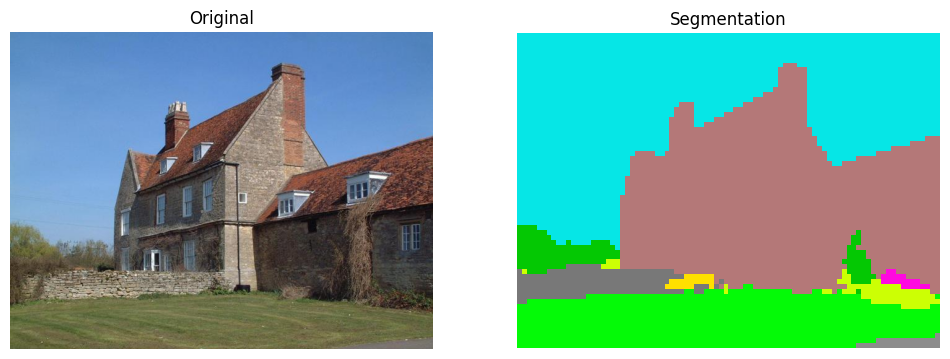

In [ ]:
plt.figure(figsize=(12,5))
plt.subplot(1,2,1)
plt.imshow(img)
plt.title("Original")
plt.axis("off")
plt.subplot(1,2,2)
plt.imshow(pred_color)
plt.title("Segmentation")
plt.axis("off")
plt.show()

**Segmentation Evaluation and Visualization**

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix

In [ ]:
# Load ground truth mask
gt_mask_path = "data/ADEChallengeData2016/annotations/validation/ADE_val_00000001.png"
gt_mask = np.array(Image.open(gt_mask_path))

In [ ]:
# Make sure pred and gt_mask are the same shape
if pred.shape != gt_mask.shape:
    pred = cv2.resize(pred.astype(np.uint8), (gt_mask.shape[1], gt_mask.shape[0]), interpolation=cv2.INTER_NEAREST)

In [ ]:
# Flatten masks
pred_flat = pred.flatten()
gt_flat = gt_mask.flatten()

In [ ]:
# Remove ignored labels (label 255)
valid_mask = gt_flat != 255
pred_flat = pred_flat[valid_mask]
gt_flat = gt_flat[valid_mask]

In [ ]:
# Compute confusion matrix
num_classes = np.max(gt_flat) + 1
conf_matrix = confusion_matrix(gt_flat, pred_flat, labels=list(range(num_classes)))

In [ ]:
# Pixel Accuracy
pixel_acc = np.diag(conf_matrix).sum() / conf_matrix.sum()

In [ ]:
# IoU per class and mean IoU
intersection = np.diag(conf_matrix)
union = conf_matrix.sum(axis=1) + conf_matrix.sum(axis=0) - np.diag(conf_matrix)
iou = intersection / np.maximum(union, 1)
mean_iou = np.mean(iou)

In [ ]:
print(f"Pixel Accuracy: {pixel_acc:.4f}")
print(f"Mean IoU: {mean_iou:.4f}")

Pixel Accuracy: 0.0091
Mean IoU: 0.0015


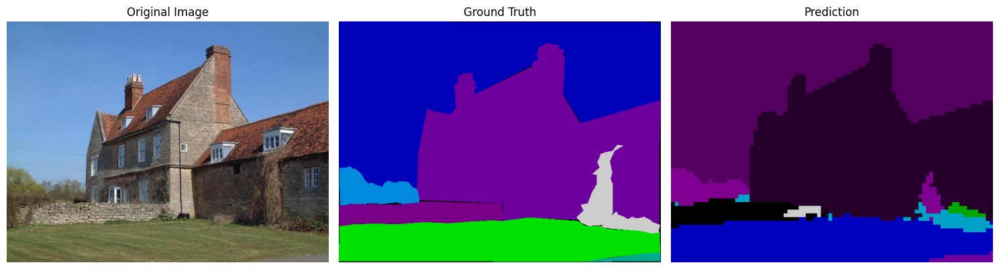

In [ ]:
# Visualize
plt.figure(figsize=(15, 5))
plt.subplot(1, 3, 1)
plt.imshow(img)
plt.title("Original Image")
plt.axis("off")

plt.subplot(1, 3, 2)
plt.imshow(gt_mask, cmap="nipy_spectral")
plt.title("Ground Truth")
plt.axis("off")

plt.subplot(1, 3, 3)
plt.imshow(pred, cmap="nipy_spectral")
plt.title("Prediction")
plt.axis("off")

plt.tight_layout()
plt.show()

# Experiment 7

In [ ]:
!pip install torchmetrics

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 961.5/961.5 kB 11.9 MB/s eta 0:00:00


Training on CPU with image size 256x256
Caching dataset...
Starting training...
Epoch 001/100 Loss: 4.9685
Epoch 002/100 Loss: 4.7022
Epoch 003/100 Loss: 4.4994
Epoch 004/100 Loss: 4.3209
Epoch 005/100 Loss: 4.1993
Epoch 006/100 Loss: 4.0174
Epoch 007/100 Loss: 3.8954
Epoch 008/100 Loss: 3.7245
Epoch 009/100 Loss: 3.5628
Epoch 010/100 Loss: 3.4352
Epoch 011/100 Loss: 3.2878
Epoch 012/100 Loss: 3.1904
Epoch 013/100 Loss: 3.0737
Epoch 014/100 Loss: 2.9676
Epoch 015/100 Loss: 2.8828
Epoch 016/100 Loss: 2.8138
Epoch 017/100 Loss: 2.7853
Epoch 018/100 Loss: 2.6347
Epoch 019/100 Loss: 2.6018
Epoch 020/100 Loss: 2.5634
Epoch 021/100 Loss: 2.5087
Epoch 022/100 Loss: 2.4216
Epoch 023/100 Loss: 2.4064
Epoch 024/100 Loss: 2.3835
Epoch 025/100 Loss: 2.3757
Epoch 026/100 Loss: 2.3216
Epoch 027/100 Loss: 2.3046
Epoch 028/100 Loss: 2.3624
Epoch 029/100 Loss: 2.2595
Epoch 030/100 Loss: 2.2503
Epoch 031/100 Loss: 2.3037
Epoch 032/100 Loss: 2.2368
Epoch 033/100 Loss: 2.2639
Epoch 034/100 Loss: 2.2083
Ep

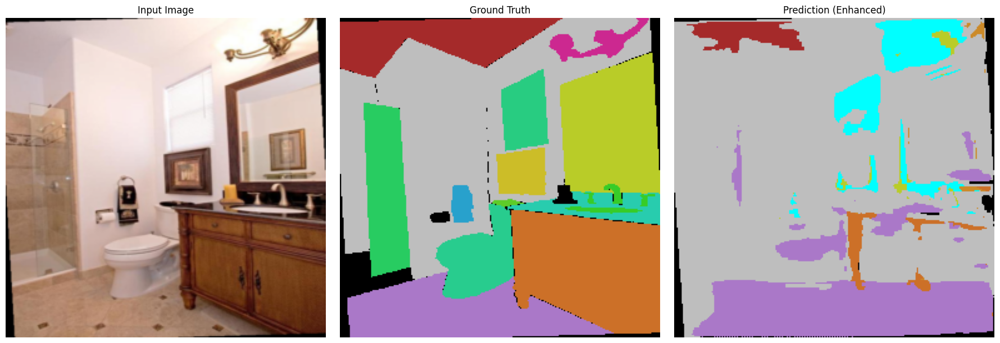

Image Index: 6
Pixel Accuracy: 0.4301
IoU: 0.4301


In [ ]:
import os
import numpy as np
import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
from PIL import Image
import matplotlib.pyplot as plt
import random
from scipy import ndimage
import colorsys

# 1. Dataset with synchronized augmentation
class ADE20KDataset(Dataset):
    def __init__(self, image_dir, mask_dir, transform=None, mask_transform=None, augment=False):
        self.image_dir = image_dir
        self.mask_dir = mask_dir
        self.image_filenames = sorted(os.listdir(image_dir))
        self.mask_filenames = sorted(os.listdir(mask_dir))
        self.transform = transform
        self.mask_transform = mask_transform
        self.augment = augment

    def __len__(self):
        return len(self.image_filenames)

    def __getitem__(self, idx):
        image_path = os.path.join(self.image_dir, self.image_filenames[idx])
        mask_path = os.path.join(self.mask_dir, self.mask_filenames[idx])
        image = Image.open(image_path).convert('RGB')
        mask = Image.open(mask_path)

        if self.augment:
            if random.random() > 0.5:
                image = image.transpose(Image.FLIP_LEFT_RIGHT)
                mask = mask.transpose(Image.FLIP_LEFT_RIGHT)

            if random.random() > 0.5:
                angle = random.uniform(-10, 10)
                image = image.rotate(angle, resample=Image.BILINEAR)
                mask = mask.rotate(angle, resample=Image.NEAREST)

        if self.transform:
            image = self.transform(image)
        if self.mask_transform:
            mask = self.mask_transform(mask)

        if mask.ndim == 3 and mask.shape[0] == 1:
            mask = mask.squeeze(0)
        mask = mask.long()
        return image, mask

# 2. Fixed U-Net with proper channel alignment
class UNet(nn.Module):
    def __init__(self, num_classes=20, base_channels=32):
        super().__init__()

        def double_conv(in_c, out_c):
            return nn.Sequential(
                nn.Conv2d(in_c, out_c, 3, padding=1),
                nn.BatchNorm2d(out_c),
                nn.ReLU(inplace=True),
                nn.Conv2d(out_c, out_c, 3, padding=1),
                nn.BatchNorm2d(out_c),
                nn.ReLU(inplace=True)
            )

        # Encoder
        self.enc1 = double_conv(3, base_channels)
        self.pool1 = nn.MaxPool2d(2)
        self.enc2 = double_conv(base_channels, base_channels*2)
        self.pool2 = nn.MaxPool2d(2)
        self.enc3 = double_conv(base_channels*2, base_channels*4)
        self.pool3 = nn.MaxPool2d(2) # Added pooling layer

        # Bridge
        self.bridge = double_conv(base_channels*4, base_channels*8) # Increased channels

        # Decoder with fixed channel counts
        self.up1 = nn.ConvTranspose2d(base_channels*8, base_channels*4, 2, stride=2) # Increased channels
        self.dec1 = double_conv(base_channels*8, base_channels*4)  # 512 -> 256 # Increased channels
        self.up2 = nn.ConvTranspose2d(base_channels*4, base_channels*2, 2, stride=2)
        self.dec2 = double_conv(base_channels*4, base_channels*2)    # 256 -> 128 # Increased channels
        self.up3 = nn.ConvTranspose2d(base_channels*2, base_channels, 2, stride=2) # Added upsampling layer
        self.dec3 = double_conv(base_channels*2, base_channels) # Added double conv layer

        # Output
        self.final = nn.Conv2d(base_channels, num_classes, 1)

    def forward(self, x):
        # Encoder
        e1 = self.enc1(x)        # (32, H, W)
        e2 = self.enc2(self.pool1(e1))  # (64, H/2, W/2)
        e3 = self.enc3(self.pool2(e2))  # (128, H/4, W/4)

        # Bridge
        b = self.bridge(self.pool3(e3))  # (256, H/8, W/8) # Changed pooling layer

        # Decoder
        d1 = self.dec1(torch.cat([self.up1(b), e3], 1))  # (128, H/4, W/4) # Changed upsampling and concatenation
        d2 = self.dec2(torch.cat([self.up2(d1), e2], 1))  # (64, H/2, W/2) # Changed upsampling and concatenation
        d3 = self.dec3(torch.cat([self.up3(d2), e1], 1)) # Added decoder layer

        return self.final(d3) # Changed output layer
# 3. Simplified CrossEntropy Loss
class CustomLoss(nn.Module):
    def __init__(self, ignore_index=255):
        super().__init__()
        self.ce = nn.CrossEntropyLoss(ignore_index=ignore_index)

    def forward(self, pred, target):
        return self.ce(pred, target)

# 4. Visualization functions
def make_semantic_palette(num_classes=20):
    palette = np.zeros((num_classes, 3), dtype=np.uint8)
    palette[0] = [0, 0, 0]       # background
    palette[1] = [190, 190, 190] # wall
    palette[2] = [150, 120, 90]  # floor
    palette[3] = [220, 220, 220] # ceiling
    palette[4] = [170, 120, 200] # bed
    palette[5] = [173, 216, 230] # window
    palette[6] = [165, 42, 42]   # door
    palette[7] = [140, 85, 45]   # table
    palette[8] = [255, 255, 255] # toilet
    palette[9] = [0, 255, 255]   # shower/sink
    for i in range(10, num_classes):
        h = i / num_classes
        s = 0.8
        v = 0.8
        r, g, b = colorsys.hsv_to_rgb(h, s, v)
        palette[i] = [int(r*255), int(g*255), int(b*255)]
    return palette

def colorize_mask(mask, palette):
    mask = mask.astype(int)
    color = np.zeros((mask.shape[0], mask.shape[1], 3), dtype=np.uint8)
    for c in np.unique(mask):
        if c == 255:
            color[mask == c] = [255,255,255]
        else:
            color[mask == c] = palette[c]
    return color

def enhance_boundaries(pred_mask):
    enhanced = np.zeros_like(pred_mask)
    for label in np.unique(pred_mask):
        if label == 255: continue
        binary = (pred_mask == label).astype(np.uint8)
        cleaned = ndimage.binary_closing(binary, structure=np.ones((3,3)))
        if np.sum(cleaned) > 100:
            cleaned = ndimage.binary_fill_holes(cleaned)
        enhanced[cleaned > 0] = label
    undefined = (enhanced == 0) & (pred_mask != 255)
    enhanced[undefined] = pred_mask[undefined]
    return enhanced

# 5. Complete training function
def train_and_visualize(
    image_dir, mask_dir,
    num_epochs=30, batch_size=8, lr=1e-3,
    num_classes=151,  # This value must match the maximum class index + 1
    img_size=128, subset_size=50
):
    device = torch.device('cpu')
    print(f"Training on CPU with image size {img_size}x{img_size}")

    # ... (rest of the function remains the same)

    transform_img = transforms.Compose([
        transforms.Resize((img_size, img_size)),
        transforms.ToTensor(),
        transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
    ])

    transform_mask = transforms.Compose([
        transforms.Resize((img_size, img_size), interpolation=Image.NEAREST),
        transforms.PILToTensor()
    ])

    dataset = ADE20KDataset(
        image_dir, mask_dir,
        transform=transform_img,
        mask_transform=transform_mask,
        augment=True
    )

    if subset_size:
        dataset = torch.utils.data.Subset(dataset, range(subset_size))

    cached_dataset = []
    print("Caching dataset...")
    for i in range(len(dataset)):
        img, mask = dataset[i]
        cached_dataset.append((img, mask))

    dataloader = DataLoader(
        cached_dataset,
        batch_size=batch_size,
        shuffle=True,
        num_workers=0,
        pin_memory=True
    )

    model = UNet(num_classes=num_classes).to(device)
    criterion = CustomLoss(ignore_index=255)
    optimizer = optim.Adam(model.parameters(), lr=lr, weight_decay=1e-4)

    best_loss = float('inf')
    patience = 5
    no_improve = 0

    print("Starting training...")
    for epoch in range(num_epochs):
        model.train()
        total_loss = 0

        for imgs, masks in dataloader:
            imgs = imgs.to(device)
            masks = masks.to(device)

            optimizer.zero_grad()
            out = model(imgs)
            loss = criterion(out, masks)
            loss.backward()
            optimizer.step()

            total_loss += loss.item()

        avg_loss = total_loss / len(dataloader)
        print(f"Epoch {epoch+1:03d}/{num_epochs} Loss: {avg_loss:.4f}")

        if avg_loss < best_loss:
            best_loss = avg_loss
            torch.save(model.state_dict(), 'best_model.pth')
            no_improve = 0
        else:
            no_improve += 1
            if no_improve >= patience:
                print(f"Early stopping at epoch {epoch+1}")
                break

    model.load_state_dict(torch.load('best_model.pth'))
    palette = make_semantic_palette(num_classes)
    model.eval()

    with torch.no_grad():
        idx = random.randint(0, len(dataset)-1)
        img, mask = dataset[idx]
        img_input = img.unsqueeze(0).to(device)
        pred = model(img_input)
        pred_mask = torch.argmax(pred, 1).squeeze().cpu().numpy()
        refined_pred = enhance_boundaries(pred_mask)
        gt_mask = mask.cpu().numpy()

        img_disp = img.permute(1,2,0).cpu().numpy()
        img_disp = img_disp * np.array([0.229, 0.224, 0.225]) + np.array([0.485, 0.456, 0.406])
        img_disp = np.clip(img_disp, 0, 1)

        plt.figure(figsize=(18, 6))
        plt.subplot(1, 3, 1)
        plt.imshow(img_disp)
        plt.title("Input Image")
        plt.axis('off')

        plt.subplot(1, 3, 2)
        plt.imshow(colorize_mask(gt_mask, palette))
        plt.title("Ground Truth")
        plt.axis('off')

        plt.subplot(1, 3, 3)
        plt.imshow(colorize_mask(refined_pred, palette))
        plt.title("Prediction (Enhanced)")
        plt.axis('off')

        plt.tight_layout()
        plt.show()

        valid = gt_mask != 255
        acc = np.mean(refined_pred[valid] == gt_mask[valid]) if np.any(valid) else 0
        intersection = np.logical_and(refined_pred == gt_mask, valid).sum()
        union = np.logical_or(refined_pred != 255, gt_mask != 255)
        union = union.sum()
        iou = intersection / union if union > 0 else 0

        print(f"Image Index: {idx}")
        print(f"Pixel Accuracy: {acc:.4f}")
        print(f"IoU: {iou:.4f}")

# 6. Execute training
train_and_visualize(
    image_dir="data/ADEChallengeData2016/images/training",
    mask_dir="data/ADEChallengeData2016/annotations/training",
    num_epochs=100,
    batch_size=8,
    num_classes=151,
    img_size=256,
    subset_size=50
)

# Experiment 8

In [ ]:
!pip install ultralytics

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 983.5/983.5 kB 15.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 1.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 44.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 20.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 46.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 5.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 13.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 2.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 87.9 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Uninstall

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from google.colab.patches import cv2_imshow

In [ ]:
def horn_schunck(im1, im2, alpha=0.05, max_iter=100, mask=None):
    im1 = im1.astype(np.float32)
    im2 = im2.astype(np.float32)
    u = np.zeros_like(im1)
    v = np.zeros_like(im1)
    Ix = cv2.Sobel(im1, cv2.CV_32F, 1, 0, ksize=3) + cv2.Sobel(im2, cv2.CV_32F, 1, 0, ksize=3)
    Iy = cv2.Sobel(im1, cv2.CV_32F, 0, 1, ksize=3) + cv2.Sobel(im2, cv2.CV_32F, 0, 1, ksize=3)
    It = im2 - im1
    kernel = np.array([[1/12, 1/6, 1/12],
                       [1/6,    0, 1/6],
                       [1/12, 1/6, 1/12]], dtype=np.float32)
    for _ in range(max_iter):
        u_avg = cv2.filter2D(u, -1, kernel)
        v_avg = cv2.filter2D(v, -1, kernel)
        denominator = alpha**2 + Ix**2 + Iy**2
        der = (Ix*u_avg + Iy*v_avg + It) / denominator
        u = u_avg - Ix * der
        v = v_avg - Iy * der
        if mask is not None:
            u = u * mask
            v = v * mask
    return u, v

In [ ]:
def visualize_flow_on_image(frame, u, v, step=10, scale=10, min_magnitude=0.5):
    vis_frame = frame.copy()
    h, w = u.shape
    x_grid, y_grid = np.meshgrid(np.arange(0, w, step), np.arange(0, h, step))
    for i, j in zip(y_grid.flatten(), x_grid.flatten()):
        if i < h and j < w:
            dx, dy = u[i, j], v[i, j]
            magnitude = np.sqrt(dx*dx + dy*dy)
            if magnitude > min_magnitude:
                # Scale the arrow for better visibility
                dx_scaled = int(dx * scale)
                dy_scaled = int(dy * scale)
                cv2.arrowedLine(vis_frame, (j, i), (j + dx_scaled, i + dy_scaled), (0, 0, 255), 2, tipLength=0.5)
    return vis_frame

In [ ]:
video_path = '/content/cctv052x2004080619x00104.avi'  # Update path as needed
cap = cv2.VideoCapture(video_path)
if not cap.isOpened():
    raise FileNotFoundError("Video file not found or unable to read")

In [ ]:
# Increase frame interval to see more motion
frame_interval = 5
frames = []
for _ in range(frame_interval + 1):
    ret, frame = cap.read()
    if not ret:
        break
    frames.append(frame)
cap.release()
if len(frames) < frame_interval + 1:
    raise ValueError("Not enough frames in the video.")

In [ ]:
frame1_gray = cv2.cvtColor(frames[0], cv2.COLOR_BGR2GRAY)
frame2_gray = cv2.cvtColor(frames[frame_interval], cv2.COLOR_BGR2GRAY)

In [ ]:
# MASK: Ignore top region (text overlay)
mask = np.ones_like(frame1_gray, dtype=np.float32)
mask[:80, :] = 0  # Adjust height as needed to cover overlay

In [ ]:
# Compute optical flow
u, v = horn_schunck(frame1_gray, frame2_gray, alpha=0.05, max_iter=100, mask=mask)

In [ ]:
# Visualize on white background
h, w = u.shape
flow_vis_white = np.ones((h, w, 3), dtype=np.uint8) * 255
step = 10
scale = 10  # Increase this value for longer arrows
for i in range(0, h, step):
    for j in range(0, w, step):
        dx, dy = u[i, j], v[i, j]
        magnitude = np.sqrt(dx*dx + dy*dy)
        if magnitude > 0.5:
            dx_scaled = int(dx * scale)
            dy_scaled = int(dy * scale)
            cv2.arrowedLine(flow_vis_white, (j, i), (j + dx_scaled, i + dy_scaled), (0, 0, 255), 2, tipLength=0.5)

In [ ]:
# Visualize on original frame
flow_vis_original = visualize_flow_on_image(frames[0], u, v, step=8, scale=scale, min_magnitude=0.4)

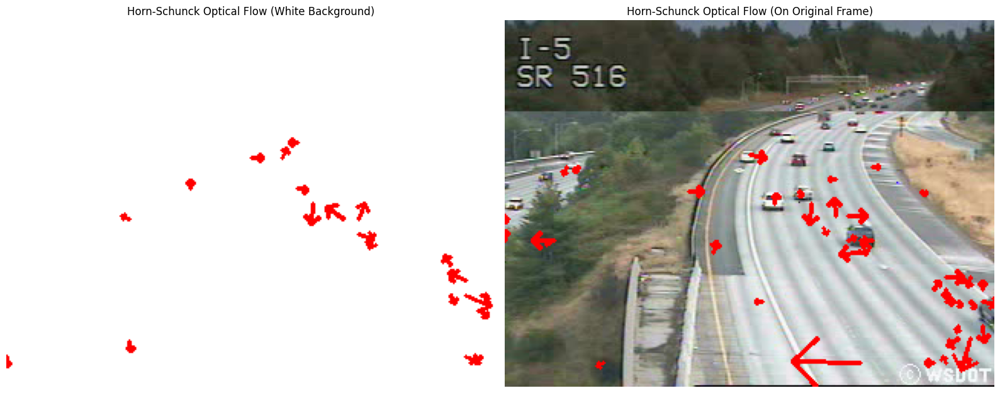

In [ ]:
# Show results (Colab-friendly)
plt.figure(figsize=(16, 8))
plt.subplot(121)
plt.imshow(cv2.cvtColor(flow_vis_white, cv2.COLOR_BGR2RGB))
plt.title('Horn-Schunck Optical Flow (White Background)')
plt.axis('off')
plt.subplot(122)
plt.imshow(cv2.cvtColor(flow_vis_original, cv2.COLOR_BGR2RGB))
plt.title('Horn-Schunck Optical Flow (On Original Frame)')
plt.axis('off')
plt.tight_layout()
plt.show()

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import os
from google.colab.patches import cv2_imshow
from IPython.display import HTML
from base64 import b64encode

def horn_schunck(im1, im2, alpha=0.05, max_iter=100, mask=None):
    im1 = im1.astype(np.float32)
    im2 = im2.astype(np.float32)
    u = np.zeros_like(im1)
    v = np.zeros_like(im1)
    Ix = cv2.Sobel(im1, cv2.CV_32F, 1, 0, ksize=3) + cv2.Sobel(im2, cv2.CV_32F, 1, 0, ksize=3)
    Iy = cv2.Sobel(im1, cv2.CV_32F, 0, 1, ksize=3) + cv2.Sobel(im2, cv2.CV_32F, 0, 1, ksize=3)
    It = im2 - im1
    kernel = np.array([[1/12, 1/6, 1/12],
                       [1/6,    0, 1/6],
                       [1/12, 1/6, 1/12]], dtype=np.float32)
    for _ in range(max_iter):
        u_avg = cv2.filter2D(u, -1, kernel)
        v_avg = cv2.filter2D(v, -1, kernel)
        denominator = alpha**2 + Ix**2 + Iy**2
        der = (Ix*u_avg + Iy*v_avg + It) / denominator
        u = u_avg - Ix * der
        v = v_avg - Iy * der
        if mask is not None:
            u = u * mask
            v = v * mask
    return u, v

def visualize_flow_on_image(frame, u, v, step=10, scale=10, min_magnitude=0.5):
    vis_frame = frame.copy()
    h, w = u.shape
    x_grid, y_grid = np.meshgrid(np.arange(0, w, step), np.arange(0, h, step))
    for i, j in zip(y_grid.flatten(), x_grid.flatten()):
        if i < h and j < w:
            dx, dy = u[i, j], v[i, j]
            magnitude = np.sqrt(dx*dx + dy*dy)
            if magnitude > min_magnitude:
                dx_scaled = int(dx * scale)
                dy_scaled = int(dy * scale)
                cv2.arrowedLine(vis_frame, (j, i), (j + dx_scaled, i + dy_scaled), (0, 0, 255), 2, tipLength=0.5)
    return vis_frame

# --- Main Processing ---

# 1. Prepare output directory for frames
os.makedirs('/content/temp_frames', exist_ok=True)

# 2. Open video
video_path = '/content/cctv052x2004080619x00104.avi'
cap = cv2.VideoCapture(video_path)
if not cap.isOpened():
    raise FileNotFoundError("Video file not found or unable to read")

# 3. Video properties
fps = int(cap.get(cv2.CAP_PROP_FPS))
width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))

# 4. Read first frame
ret, prev_frame = cap.read()
if not ret:
    raise ValueError("Could not read the first frame.")
prev_gray = cv2.cvtColor(prev_frame, cv2.COLOR_BGR2GRAY)
mask = np.ones_like(prev_gray, dtype=np.float32)
mask[:80, :] = 0  # Adjust if needed to cover text overlay

frame_count = 0
step = 10
scale = 10
min_magnitude = 0.5

print("Processing video and saving frames...")
while True:
    ret, frame = cap.read()
    if not ret:
        break

    curr_gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
    u, v = horn_schunck(prev_gray, curr_gray, alpha=0.05, max_iter=50, mask=mask)
    flow_frame = visualize_flow_on_image(frame, u, v, step=step, scale=scale, min_magnitude=min_magnitude)

    # Save frame as image
    frame_filename = f"/content/temp_frames/frame_{frame_count:04d}.jpg"
    cv2.imwrite(frame_filename, flow_frame)
    frame_count += 1

    prev_gray = curr_gray.copy()

cap.release()
print(f"Saved {frame_count} frames.")

# 5. Combine frames into a video using ffmpeg
print("Combining frames into video...")
os.system("ffmpeg -y -framerate {} -pattern_type glob -i '/content/temp_frames/*.jpg' -c:v libx264 -pix_fmt yuv420p /content/optical_flow_output.mp4".format(fps))

# 6. Display video in Colab
mp4 = open('/content/optical_flow_output.mp4','rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML(f"""
<video width=640 controls>
    <source src="{data_url}" type="video/mp4">
</video>
""")


Processing video and saving frames...
Saved 52 frames.
Combining frames into video...


# Experiment 9

In [ ]:
import kagglehub

In [ ]:
# Download latest version
path = kagglehub.dataset_download("matthewjansen/ucf101-action-recognition")

In [ ]:
print("Path to dataset files:", path)

Path to dataset files: /kaggle/input/ucf101-action-recognition


In [ ]:
# MoveNet Spatio-Temporal Analysis with Keypoint Tracking
import cv2
import numpy as np
import tensorflow as tf
import tensorflow_hub as hub
import matplotlib.pyplot as plt

In [ ]:
# Load MoveNet model
model = hub.load("https://tfhub.dev/google/movenet/singlepose/thunder/4")
movenet = model.signatures['serving_default']

**Boxing Punching Bag**

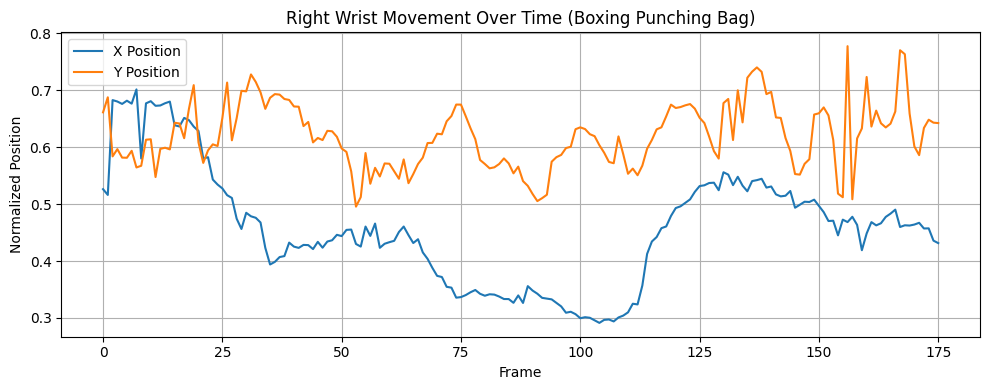

ffmpeg version 4.4.2-0ubuntu0.22.04.1 Copyright (c) 2000-2021 the FFmpeg developers
  built with gcc 11 (Ubuntu 11.2.0-19ubuntu1)
  configuration: --prefix=/usr --extra-version=0ubuntu0.22.04.1 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --arch=amd64 --enable-gpl --disable-stripping --enable-gnutls --enable-ladspa --enable-libaom --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libcodec2 --enable-libdav1d --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libjack --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librabbitmq --enable-librubberband --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libsrt --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvidstab --enable-libvorbis --enable-libvpx --enab

In [ ]:
# Load the new video for spatio-temporal analysis
video_path = '/kaggle/input/ucf101-action-recognition/test/BoxingPunchingBag/v_BoxingPunchingBag_g03_c01.avi'
cap = cv2.VideoCapture(video_path)

# Output video writer (same as before)
fourcc = cv2.VideoWriter_fourcc(*'mp4v')
out = cv2.VideoWriter('output_boxing_punching_bag_movenet.mp4', fourcc, 20.0, (256, 256))

# Function to run MoveNet (same as before)
def detect_pose(img):
    img = tf.image.resize_with_pad(tf.expand_dims(img, axis=0), 256, 256)
    input_img = tf.cast(img, dtype=tf.int32)
    outputs = movenet(input_img)
    keypoints = outputs['output_0'].numpy()[0, 0, :, :]
    return keypoints

# Function to draw keypoints (same as before)
def draw_keypoints(frame, keypoints, confidence_threshold=0.3):
    y, x, _ = frame.shape
    for kp in keypoints:
        ky, kx, kp_conf = kp
        if kp_conf > confidence_threshold:
            cx, cy = int(kx * x), int(ky * y)
            cv2.circle(frame, (cx, cy), 4, (0, 255, 0), -1)
    return frame

# Store keypoints for the new video
all_keypoints = []
while cap.isOpened():
    ret, frame = cap.read()
    if not ret:
        break
    frame = cv2.resize(frame, (256, 256))
    keypoints = detect_pose(frame)
    all_keypoints.append(keypoints)
    frame = draw_keypoints(frame, keypoints)
    out.write(frame)

cap.release()
out.release()

# Save keypoints as numpy file
np.save("keypoints_boxing_punching_bag_sequence.npy", np.array(all_keypoints))

# Example Analysis: Plot Right Wrist Movement for the new video
all_keypoints = np.array(all_keypoints)
right_wrist_x = all_keypoints[:, 10, 1]
right_wrist_y = all_keypoints[:, 10, 0]

plt.figure(figsize=(10, 4))
plt.plot(right_wrist_x, label='X Position')
plt.plot(right_wrist_y, label='Y Position')
plt.title("Right Wrist Movement Over Time (Boxing Punching Bag)")
plt.xlabel("Frame")
plt.ylabel("Normalized Position")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.savefig("right_wrist_movement_boxing_punching_bag.png")
plt.show()

# Convert the video to H264 format
!ffmpeg -i /content/output_boxing_punching_bag_movenet.mp4 -vcodec libx264 -acodec aac /content/output_boxing_punching_bag_movenet_h264.mp4

from IPython.display import HTML
from base64 import b64encode

video_path = '/content/output_boxing_punching_bag_movenet_h264.mp4'
mp4 = open(video_path, 'rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML(f"""
<video width=400 controls>
    <source src="{data_url}" type="video/mp4">
</video>
""")


**Tennis Swing**

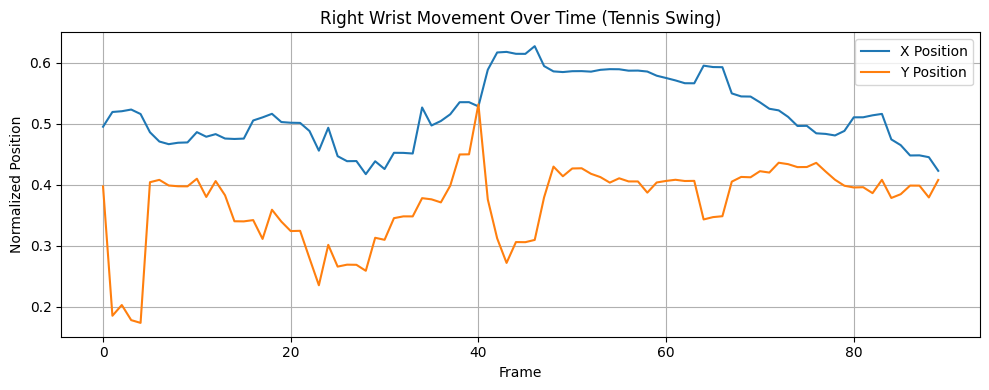

ffmpeg version 4.4.2-0ubuntu0.22.04.1 Copyright (c) 2000-2021 the FFmpeg developers
  built with gcc 11 (Ubuntu 11.2.0-19ubuntu1)
  configuration: --prefix=/usr --extra-version=0ubuntu0.22.04.1 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --arch=amd64 --enable-gpl --disable-stripping --enable-gnutls --enable-ladspa --enable-libaom --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libcodec2 --enable-libdav1d --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libjack --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librabbitmq --enable-librubberband --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libsrt --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvidstab --enable-libvorbis --enable-libvpx --enab

In [ ]:
# Load the new video for spatio-temporal analysis
video_path = '/kaggle/input/ucf101-action-recognition/test/TennisSwing/v_TennisSwing_g01_c06.avi'
cap = cv2.VideoCapture(video_path)

# Output video writer (same as before)
fourcc = cv2.VideoWriter_fourcc(*'mp4v')
out = cv2.VideoWriter('output_tennis_swing_movenet.mp4', fourcc, 20.0, (256, 256))

# Function to run MoveNet (same as before)
def detect_pose(img):
    img = tf.image.resize_with_pad(tf.expand_dims(img, axis=0), 256, 256)
    input_img = tf.cast(img, dtype=tf.int32)
    outputs = movenet(input_img)
    keypoints = outputs['output_0'].numpy()[0, 0, :, :]
    return keypoints

# Function to draw keypoints (same as before)
def draw_keypoints(frame, keypoints, confidence_threshold=0.3):
    y, x, _ = frame.shape
    for kp in keypoints:
        ky, kx, kp_conf = kp
        if kp_conf > confidence_threshold:
            cx, cy = int(kx * x), int(ky * y)
            cv2.circle(frame, (cx, cy), 4, (0, 255, 0), -1)
    return frame

# Store keypoints for the new video
all_keypoints = []
while cap.isOpened():
    ret, frame = cap.read()
    if not ret:
        break
    frame = cv2.resize(frame, (256, 256))
    keypoints = detect_pose(frame)
    all_keypoints.append(keypoints)
    frame = draw_keypoints(frame, keypoints)
    out.write(frame)

cap.release()
out.release()

# Save keypoints as numpy file
np.save("keypoints_tennis_swing_sequence.npy", np.array(all_keypoints))

# Example Analysis: Plot Right Wrist Movement for the new video
all_keypoints = np.array(all_keypoints)
right_wrist_x = all_keypoints[:, 10, 1]
right_wrist_y = all_keypoints[:, 10, 0]

plt.figure(figsize=(10, 4))
plt.plot(right_wrist_x, label='X Position')
plt.plot(right_wrist_y, label='Y Position')
plt.title("Right Wrist Movement Over Time (Tennis Swing)")
plt.xlabel("Frame")
plt.ylabel("Normalized Position")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.savefig("right_wrist_movement_tennis_swing.png")
plt.show()

# Convert the video to H264 format
!ffmpeg -i /content/output_tennis_swing_movenet.mp4 -vcodec libx264 -acodec aac /content/output_tennis_swing_movenet_h264.mp4

from IPython.display import HTML
from base64 import b64encode

video_path = '/content/output_tennis_swing_movenet_h264.mp4'
mp4 = open(video_path, 'rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML(f"""
<video width=400 controls>
    <source src="{data_url}" type="video/mp4">
</video>
""")


# Experiment 10: Mini Project

In [ ]:
import zipfile
import os

In [ ]:
# Specify the path to your zip file and the extraction path
zip_file_path = "/content/Football.zip"
extract_path = "/content/"

In [ ]:
# Open the zip file in read mode
with zipfile.ZipFile(zip_file_path, 'r') as zip_ref:
    # Extract all the contents to the specified path
    zip_ref.extractall(extract_path)
print("Extraction complete. Files stored in: ", extract_path)

Extraction complete. Files stored in:  /content/


**1️⃣ Install Dependencies**

In [ ]:
!pip install ultralytics opencv-python numpy matplotlib torch torchvision torchaudio tensorflow keras easyocr pandas

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 984.0/984.0 kB 18.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 1.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 71.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 56.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 46.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 3.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 1.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 14.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 5.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 62.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.9/2.9 MB 71.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4

In [ ]:
dataset_path = r"/content/Football/Football/football_players_detection"
# Check if the paths exist
for folder in ["train/images", "train/labels", "valid/images", "valid/labels", "test/images", "test/labels"]:
    path = os.path.join(dataset_path, folder)
    print(f"Checking {path}: {'Exists' if os.path.exists(path) else 'Not Found'}")

Checking /content/Football/Football/football_players_detection/train/images: Exists
Checking /content/Football/Football/football_players_detection/train/labels: Exists
Checking /content/Football/Football/football_players_detection/valid/images: Exists
Checking /content/Football/Football/football_players_detection/valid/labels: Exists
Checking /content/Football/Football/football_players_detection/test/images: Exists
Checking /content/Football/Football/football_players_detection/test/labels: Exists


**🔹 Step 2: Load and Visualize the Dataset**

In [ ]:
import warnings
warnings.filterwarnings('ignore')

In [ ]:
import cv2
import matplotlib.pyplot as plt
import os
import random

In [ ]:
# Train Image Directory
train_img_dir = os.path.join(dataset_path, "train/images")

In [ ]:
# Get all image files
image_files = [f for f in os.listdir(train_img_dir) if f.endswith(".jpg")]

In [ ]:
# Select 5 random images
sample_images = random.sample(image_files, 5)

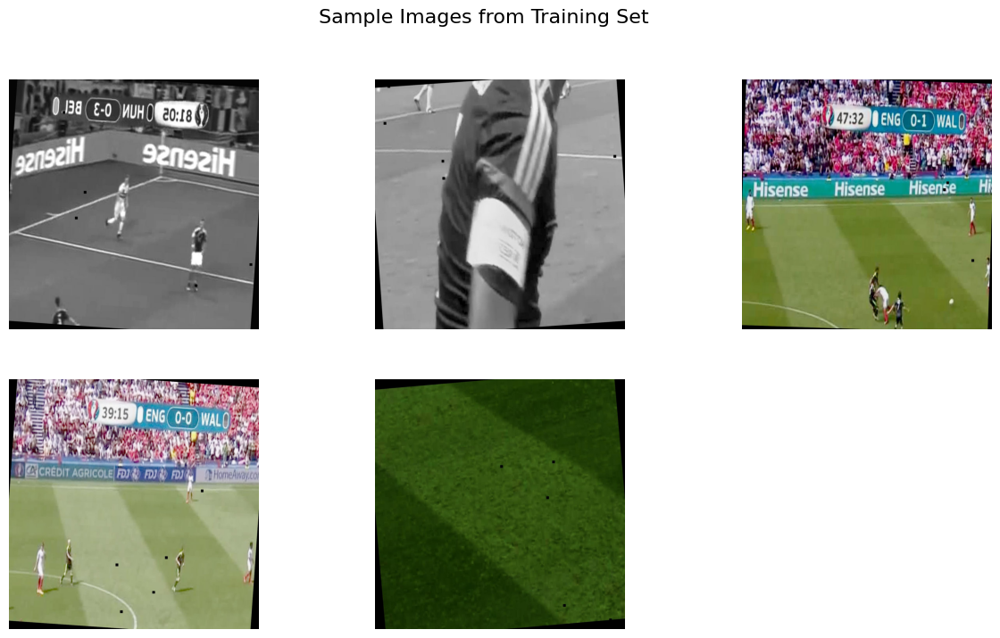

In [ ]:
# Display images
plt.figure(figsize=(15, 8))
for i, img_file in enumerate(sample_images):
    img_path = os.path.join(train_img_dir, img_file)
    img = cv2.imread(img_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)  # Convert from BGR to RGB for correct color
    plt.subplot(2, 3, i + 1)
    plt.imshow(img)
    plt.axis("off")
plt.suptitle("Sample Images from Training Set", fontsize=16)
plt.show()

**📌 Step 3.1: Function to Draw Bounding Boxes**

In [ ]:
import numpy as np

In [ ]:
# Path to label files
train_label_dir = os.path.join(dataset_path, "train/labels")

In [ ]:
# Function to draw bounding boxes
def draw_bounding_boxes(image_path, label_path):
    # Load image
    img = cv2.imread(image_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    h, w, _ = img.shape  # Get image dimensions
    # Read label file
    if not os.path.exists(label_path):
        return img  # Return original image if no label file found
    with open(label_path, "r") as file:
        labels = file.readlines()
    # Draw bounding boxes
    for label in labels:
        values = label.strip().split()
        class_id, x_center, y_center, width, height = map(float, values)
        # Convert YOLO format to pixel coordinates
        x1 = int((x_center - width / 2) * w)
        y1 = int((y_center - height / 2) * h)
        x2 = int((x_center + width / 2) * w)
        y2 = int((y_center + height / 2) * h)
        # Draw rectangle
        cv2.rectangle(img, (x1, y1), (x2, y2), (255, 0, 0), 2)
        # Put class label
        cv2.putText(img, f"Class {int(class_id)}", (x1, y1 - 10),
                    cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 0, 0), 2)
    return img

**📌 Step 3.2: Display Images with Bounding Boxes**

In [ ]:
# Select 3 random images
sample_images = random.sample(image_files, 3)

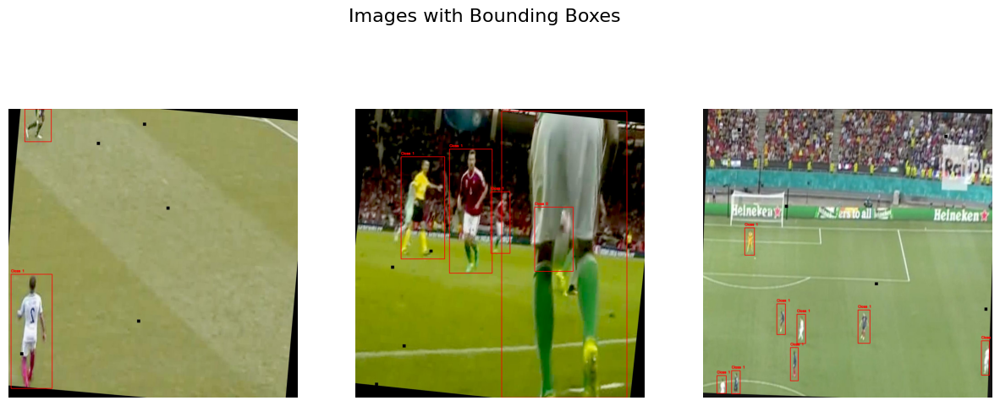

In [ ]:
plt.figure(figsize=(15, 6))
for i, img_file in enumerate(sample_images):
    img_path = os.path.join(train_img_dir, img_file)
    label_path = os.path.join(train_label_dir, img_file.replace(".jpg", ".txt"))
    # Draw bounding boxes
    img_with_boxes = draw_bounding_boxes(img_path, label_path)
    # Display image
    plt.subplot(1, 3, i + 1)
    plt.imshow(img_with_boxes)
    plt.axis("off")
plt.suptitle("Images with Bounding Boxes", fontsize=16)
plt.show()

**Step 3.3: Data Preprocessing & Augmentation 🚀**

In [ ]:
import os
import cv2
import torch
import torchvision.transforms as transforms
import matplotlib.pyplot as plt
from PIL import Image

In [ ]:
# Define preprocessing transformations
transform = transforms.Compose([
    transforms.Resize((416, 416)),  # Resize all images to 416x416 (YOLO input size)
    transforms.ColorJitter(brightness=0.2, contrast=0.2, saturation=0.2, hue=0.1),  # Adjust brightness & contrast
    transforms.RandomHorizontalFlip(p=0.5),  # Randomly flip images
    transforms.RandomAffine(degrees=10, translate=(0.1, 0.1), scale=(0.8, 1.2)),  # Rotation, translation & scaling
    transforms.ToTensor(),  # Convert to tensor
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])  # Normalize (pretrained model requirement)
])

In [ ]:
# Load a sample image
image_dir = r"/content/Football/Football/football_players_detection/train/images"
sample_image_path = os.path.join(image_dir, os.listdir(image_dir)[0])  # Pick first image
img = Image.open(sample_image_path)

In [ ]:
# Apply transformations
augmented_img = transform(img)

In [ ]:
# Convert back to numpy for visualization
def tensor_to_image(tensor):
    tensor = tensor.permute(1, 2, 0)  # Rearrange dimensions (C, H, W) → (H, W, C)
    tensor = tensor * torch.tensor([0.229, 0.224, 0.225]) + torch.tensor([0.485, 0.456, 0.406])  # Denormalize
    tensor = tensor.numpy()
    tensor = (tensor * 255).astype("uint8")  # Convert to uint8 format
    return tensor

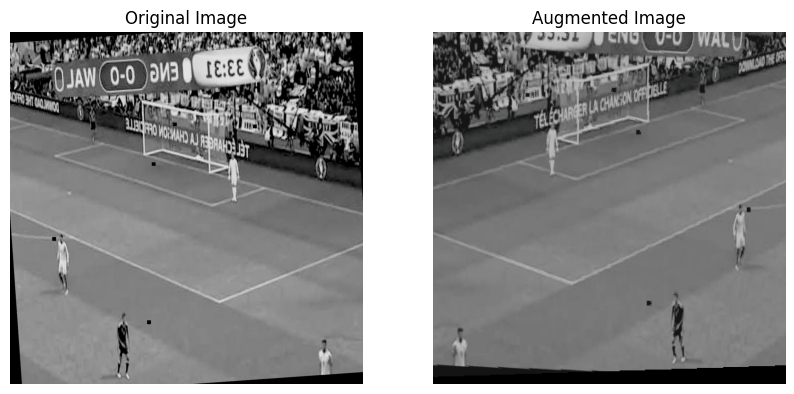

In [ ]:
# Visualize original & augmented images
fig, ax = plt.subplots(1, 2, figsize=(10, 5))
ax[0].imshow(img)
ax[0].set_title("Original Image")
ax[0].axis("off")
ax[1].imshow(tensor_to_image(augmented_img))
ax[1].set_title("Augmented Image")
ax[1].axis("off")
plt.show()

**🔹 Step 4: Data Augmentation for Object Detection**

**📌 Step 4.1: Install Dependencies**

In [ ]:
!pip install albumentations opencv-python numpy matplotlib

**📌 Step 4.2: Define Augmentation Pipeline**

In [ ]:
import albumentations as A
import cv2
import os
import numpy as np
import random
import matplotlib.pyplot as plt

In [ ]:
augmentations = A.Compose([
    A.HorizontalFlip(p=0.5),
    A.RandomBrightnessContrast(p=0.5),
    A.Rotate(limit=10, p=0.5, border_mode=cv2.BORDER_REFLECT_101, fit_output=True),
    A.GaussianBlur(blur_limit=(3,7), p=0.3),
    A.GaussNoise(var_limit=(10.0, 50.0), p=0.3)
], bbox_params=A.BboxParams(format="yolo", label_fields=["class_labels"]))

In [ ]:
# Function to apply augmentation
def augment_image(image_path, label_path):
    img = cv2.imread(image_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    h, w, _ = img.shape  # Get image dimensions
    if not os.path.exists(label_path):
        return img, [], [], h, w  # No label file, return original image
    # Read bounding boxes
    with open(label_path, "r") as file:
        labels = file.readlines()
    bboxes = []
    class_labels = []
    for label in labels:
        values = label.strip().split()
        class_id, x_center, y_center, width, height = map(float, values)
        bboxes.append([x_center, y_center, width, height])
        class_labels.append(int(class_id))
    # Apply augmentation
    augmented = augmentations(image=img, bboxes=bboxes, class_labels=class_labels)
    return augmented["image"], augmented["bboxes"], augmented["class_labels"], h, w  # Return image size

In [ ]:
# Display augmented images
sample_images = random.sample(image_files, 3)

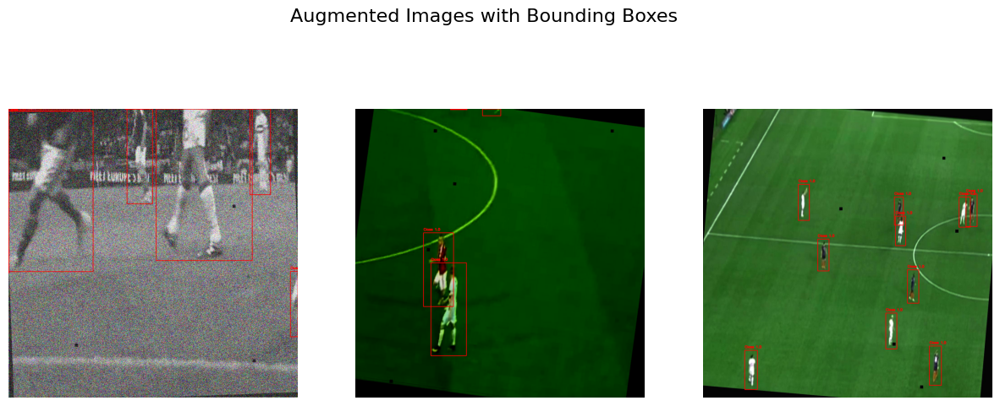

In [ ]:
plt.figure(figsize=(15, 6))
for i, img_file in enumerate(sample_images):
    img_path = os.path.join(train_img_dir, img_file)
    label_path = os.path.join(train_label_dir, img_file.replace(".jpg", ".txt"))
    # Apply augmentation
    aug_img, aug_bboxes, aug_labels, h, w = augment_image(img_path, label_path)
    # Draw bounding boxes
    for bbox, cls in zip(aug_bboxes, aug_labels):
        x1 = int((bbox[0] - bbox[2] / 2) * w)
        y1 = int((bbox[1] - bbox[3] / 2) * h)
        x2 = int((bbox[0] + bbox[2] / 2) * w)
        y2 = int((bbox[1] + bbox[3] / 2) * h)
        cv2.rectangle(aug_img, (x1, y1), (x2, y2), (255, 0, 0), 2)
        cv2.putText(aug_img, f"Class {cls}", (x1, y1 - 10),
                    cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 0, 0), 2)
    # Display
    plt.subplot(1, 3, i + 1)
    plt.imshow(aug_img)
    plt.axis("off")
plt.suptitle("Augmented Images with Bounding Boxes", fontsize=16)
plt.show()

**🔹 Step 5: Model Performance Testing**

**📌 Step 5: Single Stage Models: SSD Implementation**

In [ ]:
import torch
import torchvision
import cv2
import numpy as np
import time
from torchvision.transforms import functional as F
from IPython.display import display, HTML

In [ ]:
# Load a pretrained SSD model (COCO dataset)
model = torchvision.models.detection.ssd300_vgg16(pretrained=True)
model.eval()  # Set model to evaluation mode

SSD(
  (backbone): SSDFeatureExtractorVGG(
    (features): Sequential(
      (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): ReLU(inplace=True)
      (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (3): ReLU(inplace=True)
      (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
      (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (6): ReLU(inplace=True)
      (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (8): ReLU(inplace=True)
      (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
      (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (11): ReLU(inplace=True)
      (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (13): ReLU(inplace=True)
      (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (15): ReLU(inplace=

In [ ]:
# Load video
video_path = "/content/Football/Football/video.mp4"  # Replace with your video
cap = cv2.VideoCapture(video_path)

In [ ]:
# Get video properties
fps = cap.get(cv2.CAP_PROP_FPS)
width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))

In [ ]:
# Define output video file (processed)
output_video_path = "processed_footballs.mp4"
fourcc = cv2.VideoWriter_fourcc(*'mp4v')  # Codec for MP4
out = cv2.VideoWriter(output_video_path, fourcc, fps, (width, height))

In [ ]:
# COCO class labels (Only tracking "person" and "sports ball")
FOOTBALL_CLASSES = {"person": (0, 255, 0), "sports ball": (255, 0, 0)}  # Green for players, Blue for ball

In [ ]:
# Process each frame
while cap.isOpened():
    ret, frame = cap.read()
    if not ret:
        break  # Exit when video ends
    # Convert frame to RGB & Tensor
    image_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
    image_tensor = F.to_tensor(image_rgb).unsqueeze(0)
    # Perform inference
    with torch.no_grad():
        predictions = model(image_tensor)
    # Extract results
    boxes = predictions[0]['boxes'].cpu().numpy()
    labels = predictions[0]['labels'].cpu().numpy()
    scores = predictions[0]['scores'].cpu().numpy()
    # Draw bounding boxes
    for i, box in enumerate(boxes):
        label_idx = labels[i]
        confidence = scores[i]
        # Use different confidence thresholds
        if (label_idx == 1 and confidence > 0.30) or (label_idx == 37 and confidence > 0.04):
            label = "person" if label_idx == 1 else "sports ball"
            x1, y1, x2, y2 = map(int, box)
            color = FOOTBALL_CLASSES[label]  # Green for players, Blue for ball
            # Draw bounding box
            cv2.rectangle(frame, (x1, y1), (x2, y2), color, 2)
            cv2.putText(frame, f"{label}: {confidence:.2f}", (x1, y1 - 10),
                        cv2.FONT_HERSHEY_SIMPLEX, 0.5, color, 2)
    # Write processed frame to output video
    out.write(frame)
# Release resources
cap.release()
out.release()

In [ ]:
!ffmpeg -i /content/processed_footballs.mp4 -c:v libvpx-vp9 -b:v 2M -c:a libvorbis processed_footballs.webm

from IPython.display import Video
Video("processed_footballs.webm", embed=True, width=800, height=450)

ffmpeg version 4.4.2-0ubuntu0.22.04.1 Copyright (c) 2000-2021 the FFmpeg developers
  built with gcc 11 (Ubuntu 11.2.0-19ubuntu1)
  configuration: --prefix=/usr --extra-version=0ubuntu0.22.04.1 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --arch=amd64 --enable-gpl --disable-stripping --enable-gnutls --enable-ladspa --enable-libaom --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libcodec2 --enable-libdav1d --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libjack --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librabbitmq --enable-librubberband --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libsrt --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvidstab --enable-libvorbis --enable-libvpx --enab

**Step 6: Hyperparameter Tuning for SSD 🚀**

In [ ]:
import os
image_dir = r"/content/Football/Football/football_players_detection/train/images"  # Corrected path

In [ ]:
# Get the list of image files
image_files = [os.path.join(image_dir, f) for f in os.listdir(image_dir) if f.endswith(('.jpg', '.jpeg', '.png'))]

In [ ]:
import cv2
import os

In [ ]:
# Paths to model files
MODEL_CONFIG = "/content/Football/Football/deploy.prototxt"
MODEL_WEIGHTS = "/content/Football/Football/mobilenet_iter_73000.caffemodel"

In [ ]:
# Ensure model files exist
if not os.path.exists(MODEL_CONFIG) or not os.path.exists(MODEL_WEIGHTS):
    raise FileNotFoundError("Model config or weights file not found!")

In [ ]:
# Define function to load SSD model
def load_ssd(score_thresh, nms_thresh):
    net = cv2.dnn.readNetFromCaffe(MODEL_CONFIG, MODEL_WEIGHTS)
    net.setPreferableBackend(cv2.dnn.DNN_BACKEND_OPENCV)  # ✅ Ensures CPU execution
    return net, score_thresh, nms_thresh

In [ ]:
# Define function to run detection
def evaluate_model(net, score_thresh, nms_thresh, image_files):
    total_detections = 0
    for image_path in image_files:
        image = cv2.imread(image_path)
        if image is None:
            print(f"❌ Error loading image: {image_path}")
            continue
        h, w = image.shape[:2]
        # Preprocessing for SSD model
        blob = cv2.dnn.blobFromImage(image, 1.0, (300, 300), (127.5, 127.5, 127.5), swapRB=True, crop=False)
        net.setInput(blob)
        detections = net.forward()  # Run inference
        # Process detections
        for i in range(detections.shape[2]):
            confidence = detections[0, 0, i, 2]
            if confidence > score_thresh:  # Apply confidence threshold
                total_detections += 1
    return total_detections / len(image_files)  # Return avg detections per image

In [ ]:
# Define hyperparameter search space
score_thresholds = [0.2, 0.4]
nms_thresholds = [0.2, 0.4]

In [ ]:
# Run tuning
best_params = None
max_detections = -1

In [ ]:
for score_thresh in score_thresholds:
    for nms_thresh in nms_thresholds:
        print(f"🔍 Evaluating: Score {score_thresh}, NMS {nms_thresh}")
        net, s_thresh, n_thresh = load_ssd(score_thresh, nms_thresh)
        avg_detections = evaluate_model(net, s_thresh, n_thresh, image_files)
        print(f"✅ Score: {s_thresh}, NMS: {n_thresh} → Avg Detections: {avg_detections}")
        if avg_detections > max_detections:
            max_detections = avg_detections
            best_params = (s_thresh, n_thresh)
print(f"\n🏆 Best Hyperparameters: Score {best_params[0]}, NMS {best_params[1]}")

🔍 Evaluating: Score 0.2, NMS 0.2
✅ Score: 0.2, NMS: 0.2 → Avg Detections: 0.18141249514939853
🔍 Evaluating: Score 0.2, NMS 0.4
✅ Score: 0.2, NMS: 0.4 → Avg Detections: 0.18141249514939853
🔍 Evaluating: Score 0.4, NMS 0.2
✅ Score: 0.4, NMS: 0.2 → Avg Detections: 0.13630190143577803
🔍 Evaluating: Score 0.4, NMS 0.4
✅ Score: 0.4, NMS: 0.4 → Avg Detections: 0.13630190143577803

🏆 Best Hyperparameters: Score 0.2, NMS 0.2


**Step 7: Multi-Stage Models**

**Mask RCNN**

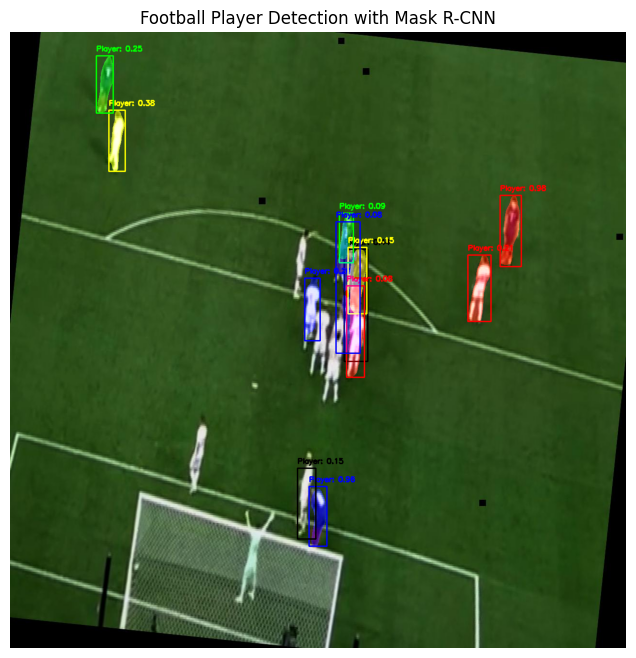

In [ ]:
import torch
import torchvision
from torchvision.models.detection import maskrcnn_resnet50_fpn
import torchvision.transforms as transforms
from PIL import Image
import matplotlib.pyplot as plt
import numpy as np
import cv2

# Load pre-trained Mask R-CNN model
model = maskrcnn_resnet50_fpn(pretrained=True)
model.eval()  # Set to evaluation mode

# Football-specific color scheme - team colors + referee
FOOTBALL_COLORS = [
    (255, 0, 0),     # Red (Team 1)
    (0, 0, 255),     # Blue (Team 2)
    (0, 0, 0),       # Black (Referee)
    (255, 255, 0),   # Yellow (Goalkeeper 1)
    (0, 255, 0)      # Green (Goalkeeper 2)
]

# Process image for inference
def preprocess_image(image_path):
    image = Image.open(image_path).convert("RGB")
    transform = transforms.Compose([
        transforms.ToTensor()
    ])
    return transform(image).unsqueeze(0)

# Run Mask R-CNN inference
def detect_football_players(image_path, conf_threshold=0.5):
    # Load and preprocess image
    image_tensor = preprocess_image(image_path)

    # Run inference
    with torch.no_grad():
        predictions = model(image_tensor)

    # Filter predictions (only keep person class - index 1 in COCO)
    keep_indices = []
    for i, label in enumerate(predictions[0]['labels']):
        if label == 1 and predictions[0]['scores'][i] > conf_threshold:  # 1 is person in COCO
            keep_indices.append(i)

    filtered_predictions = {
        'boxes': predictions[0]['boxes'][keep_indices],
        'masks': predictions[0]['masks'][keep_indices],
        'scores': predictions[0]['scores'][keep_indices],
        'labels': predictions[0]['labels'][keep_indices]
    }

    return filtered_predictions

# Visualize with football-themed colors
def visualize_football_detection(image_path, predictions):
    # Load original image
    image = np.array(Image.open(image_path).convert("RGB"))
    h, w = image.shape[:2]

    # Create overlay for visualization
    overlay = image.copy()

    # Process each detected player
    for i in range(len(predictions['boxes'])):
        # Get mask and box
        mask = predictions['masks'][i, 0].numpy()
        box = predictions['boxes'][i].numpy().astype(int)
        score = predictions['scores'][i].item()

        # Apply color (cycling through team colors)
        color = FOOTBALL_COLORS[i % len(FOOTBALL_COLORS)]

        # Create binary mask (threshold at 0.5)
        binary_mask = (mask > 0.5).astype(np.uint8)

        # Create colored mask for this player
        colored_mask = np.zeros((h, w, 3), dtype=np.uint8)
        for c in range(3):
            colored_mask[:, :, c] = binary_mask * color[c]

        # Apply mask with transparency
        overlay = cv2.addWeighted(overlay, 1.0, colored_mask, 0.5, 0)

        # Draw bounding box
        x1, y1, x2, y2 = box
        cv2.rectangle(overlay, (x1, y1), (x2, y2), color, 2)

        # Add confidence score
        label_text = f"Player: {score:.2f}"
        cv2.putText(overlay, label_text, (x1, y1-10),
                    cv2.FONT_HERSHEY_SIMPLEX, 0.5, color, 2)

    # Display result
    plt.figure(figsize=(12, 8))
    plt.imshow(overlay)
    plt.axis('off')
    plt.title("Football Player Detection with Mask R-CNN")
    plt.show()

    return overlay

# Example usage for football images/video frames
image_path = "/content/Football/Football/football_players_detection/train/images/123_pp_jpg.rf.18c06bae5f4e4ed05650e13149745044.jpg"  # Update with your image path
football_detections = detect_football_players(image_path, conf_threshold=0.07)
result_image = visualize_football_detection(image_path, football_detections)


**Step 8: Optical Flow Algorithm for Estimation of Motion**

**Horn and Schunk**

In [ ]:
import cv2
import numpy as np
import os
from IPython.display import Video

# ========== HORN-SCHUNCK OPTICAL FLOW IMPLEMENTATION ==========
def horn_schunck(im1, im2, alpha=0.1, max_iter=50):
    """Compute optical flow between two grayscale frames"""
    im1 = im1.astype(np.float32)
    im2 = im2.astype(np.float32)

    # Initialize flow matrices
    u = np.zeros_like(im1)
    v = np.zeros_like(im1)

    # Compute image gradients
    Ix = cv2.Sobel(im1, cv2.CV_32F, 1, 0, ksize=3)
    Iy = cv2.Sobel(im1, cv2.CV_32F, 0, 1, ksize=3)
    It = im2 - im1  # Temporal derivative

    # Kernel for neighborhood averaging
    kernel = np.array([[1/12, 1/6, 1/12],
                       [1/6,  0,   1/6],
                       [1/12, 1/6, 1/12]], np.float32)

    for _ in range(max_iter):
        # Compute local averages of flow vectors
        u_avg = cv2.filter2D(u, -1, kernel)
        v_avg = cv2.filter2D(v, -1, kernel)

        # Update flow equations
        denominator = alpha**2 + Ix**2 + Iy**2
        der = (Ix*u_avg + Iy*v_avg + It) / (denominator + 1e-7)
        u = u_avg - Ix * der
        v = v_avg - Iy * der

    return u, v

def visualize_flow(frame, u, v, step=10, scale=5, min_magnitude=1.0, max_magnitude=10.0):
    """Draw optical flow vectors with BOTH min and max magnitude thresholds"""
    h, w = frame.shape[:2]
    vis_frame = frame.copy()

    # Create grid of points
    y, x = np.mgrid[0:h:step, 0:w:step].reshape(2, -1).astype(int)

    # Calculate vectors
    fx = u[y, x]
    fy = v[y, x]
    mag = np.sqrt(fx**2 + fy**2)

    # Filter by magnitude - BOTH min AND max
    valid = (mag > min_magnitude) & (mag < max_magnitude)
    x = x[valid]
    y = y[valid]
    fx = fx[valid]
    fy = fy[valid]

    # Draw vectors
    for (xi, yi, dx, dy) in zip(x, y, fx, fy):
        color = (0, 0, 255) if dx > 0 else (255, 0, 0)  # Red-right, Blue-left
        cv2.arrowedLine(vis_frame,
                      (xi, yi),
                      (xi + int(dx*scale), yi + int(dy*scale)),
                      color, 2, tipLength=0.3)
    return vis_frame

def process_video(input_path, output_path):
    """Main processing function"""
    # Delete existing files
    if os.path.exists(output_path):
        os.remove(output_path)

    # Open video
    cap = cv2.VideoCapture(input_path)
    if not cap.isOpened():
        raise FileNotFoundError(f"Couldn't open video: {input_path}")

    # Get video properties
    fps = int(cap.get(cv2.CAP_PROP_FPS))
    width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
    height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))

    # Create video writer
    fourcc = cv2.VideoWriter_fourcc(*'mp4v')
    out = cv2.VideoWriter(output_path, fourcc, fps, (width, height))

    # Read first frame
    ret, prev_frame = cap.read()
    prev_gray = cv2.cvtColor(prev_frame, cv2.COLOR_BGR2GRAY)

    # Create mask to ignore top 20% (scoreboards)
    mask = np.ones_like(prev_gray, dtype=np.float32)
    mask[:int(height*0.15), :] = 0  # Mask top 15% (scoreboard area)

    print("Processing video...")
    frame_count = 0
    total_frames = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))

    while cap.isOpened():
        ret, frame = cap.read()
        if not ret:
            break

        # Convert to grayscale
        curr_gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)

        # Compute optical flow
        u, v = horn_schunck(prev_gray, curr_gray)

        # Apply mask
        u *= mask
        v *= mask

        # Visualize flow with both min and max thresholds
        flow_frame = visualize_flow(frame, u, v,
                                  step=8,              # Higher density sampling
                                  scale=5,             # Smaller arrows
                                  min_magnitude=1.0,   # Filter small movements
                                  max_magnitude=8.0)   # Cap large movements

        # Write frame
        out.write(flow_frame)
        prev_gray = curr_gray.copy()

        # Show progress
        frame_count += 1
        if frame_count % 20 == 0:
            print(f"Processed {frame_count}/{total_frames} frames ({frame_count/total_frames*100:.1f}%)")

    # Cleanup
    cap.release()
    out.release()
    print("Processing complete!")

# ========== EXECUTION ==========
input_video = "/content/Football/Football/video.mp4"
output_mp4 = "/content/processed_football.mp4"
output_webm = "processed_football.webm"

# 1. Process video with optical flow
process_video(input_video, output_mp4)

# 2. Convert to webm using ffmpeg
!ffmpeg -y -i {output_mp4} -c:v libvpx-vp9 -b:v 2M -c:a libvorbis {output_webm}

# 3. Display in Colab
Video(output_webm, embed=True, width=800, height=450)

Processing video...
Processed 20/449 frames (4.5%)
Processed 40/449 frames (8.9%)
Processed 60/449 frames (13.4%)
Processed 80/449 frames (17.8%)
Processed 100/449 frames (22.3%)
Processed 120/449 frames (26.7%)
Processed 140/449 frames (31.2%)
Processed 160/449 frames (35.6%)
Processed 180/449 frames (40.1%)
Processed 200/449 frames (44.5%)
Processed 220/449 frames (49.0%)
Processed 240/449 frames (53.5%)
Processed 260/449 frames (57.9%)
Processed 280/449 frames (62.4%)
Processed 300/449 frames (66.8%)
Processed 320/449 frames (71.3%)
Processed 340/449 frames (75.7%)
Processed 360/449 frames (80.2%)
Processed 380/449 frames (84.6%)
Processed 400/449 frames (89.1%)
Processed 420/449 frames (93.5%)
Processed 440/449 frames (98.0%)
Processing complete!
ffmpeg version 4.4.2-0ubuntu0.22.04.1 Copyright (c) 2000-2021 the FFmpeg developers
  built with gcc 11 (Ubuntu 11.2.0-19ubuntu1)
  configuration: --prefix=/usr --extra-version=0ubuntu0.22.04.1 --toolchain=hardened --libdir=/usr/lib/x86_64